<a href="https://colab.research.google.com/github/1kaiser/test2022/blob/main/MLP_Image_Train_Inference.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

### Model and training code

Our model is a coordinate-based multilayer perceptron. In this example, for each input image coordinate $(x,y)$, the model predicts the associated color $(r,g,b)$ or any $(gray)$.

![Network diagram](https://user-images.githubusercontent.com/3310961/85066930-ad444580-b164-11ea-9cc0-17494679e71f.png)

[--xla_force_host_platform_device_count](https://jax.readthedocs.io/en/latest/jax-101/06-parallelism.html#:~:text=When%20running%20on-,CPU,-you%20can%20always)

In [ ]:
#✅
import os
os.environ['XLA_FLAGS'] = '--xla_force_host_platform_device_count=8'
import jax
jax.devices()

In [ ]:
#✅
import jax
import jax.numpy as jnp

positional_encoding_dims = 6  # Number of positional encodings applied

def positional_encoding(inputs):
    print("positional_encoding start")
    batch_size, _ = inputs.shape;print(inputs.shape)
    inputs_freq = jax.vmap(lambda x: inputs * 2.0 ** x)(jnp.arange(positional_encoding_dims));print(inputs_freq.shape)
    x = jnp.stack([jnp.sin(inputs_freq), jnp.cos(inputs_freq)]);print(x.shape)
    x = x.swapaxes(0, 2);print(x.shape)
    x = x.reshape([batch_size, -1]);print(x.shape)
    x = jnp.concatenate([inputs, x], axis=-1);print(x.shape)
    print("positional_encoding end")
    return x



### MLP MODEL
Basically, passing input points through a simple Fourier Feature Mapping enables an MLP to learn high-frequency functions (such as an RGB image) in low-dimensional problem domains (such as a 2D coordinate of pixels).

In [ ]:
#✅
!python -m pip install -q -U flax

import jax
import jax.numpy as jnp

import flax
import optax
from typing import Any

from jax import lax
import flax.linen as nn
from flax.training import train_state, common_utils
apply_positional_encoding = True # Apply posittional encoding to the input or not
num_dense_layers = 8 # Number of dense layers in MLP
dense_layer_width = 256 # Dimentionality of dense layers' output space 

##########################################<< MLP MODEL >>#########################################
class MLPModel(nn.Module):
    dtype: Any = jnp.float32
    precision: Any = lax.Precision.DEFAULT
    apply_positional_encoding: bool = apply_positional_encoding
    @nn.compact
    def __call__(self, input_points):
        x = positional_encoding(input_points) if self.apply_positional_encoding else input_points
        print("network model start")
        print(x.shape)
        for i in range(num_dense_layers):
            x = nn.Dense(
                dense_layer_width,
                dtype=self.dtype,
                precision=self.precision
                )(x)
            x = nn.relu(x)
            x = jnp.concatenate([x, input_points], axis=-1) if i == 4 else x
            print(x.shape)
  
        x = nn.Dense(1, dtype=self.dtype, precision=self.precision)(x)
        print(x.shape)
        print("network model end")
        return x
##########################################<< MLP MODEL >>#########################################

### initialize the module

In [ ]:
#✅
!python -m pip install -q -U flax
import optax
from flax.training import train_state
import jax.numpy as jnp
import jax


def init_train_state(model, r_key, shape, learning_rate ) -> train_state.TrainState:
    print(shape)
    # BATCH, image_height, image_width, cha = shape
    # size = image_height * image_width
    # yt = jnp.ones((size, cha))
    init_variables = model.init(r_key, jnp.ones(shape))  # Initialize the Model
    optimizer = optax.adam(learning_rate) # Create the optimizer
    # Create a State
    return train_state.TrainState.create(
        apply_fn = model.apply,
        tx=optimizer,
        params=init_variables['params']
    )

learning_rate = 1e-4
batch_size_no = 64

model = MLPModel() # Instantiate the Model
key, rng = jax.random.split(jax.random.PRNGKey(0))
x = jnp.ones(shape=(batch_size_no, 28, 28, 1)) # Dummy Input
_, image_height, image_width, channels = x.shape
state = init_train_state( model, rng, (image_height * image_width, channels), learning_rate )


In [25]:
def image_difference_loss(logits, labels):
    loss = .5 * jnp.mean((logits - labels) ** 2)
    return loss
def compute_metrics(*, logits, labels):
  loss = image_difference_loss(logits, labels)
  loss = lax.pmean(loss, axis_name="batch");print("ok4")
  metrics = {
      'loss': loss,
      'logits': logits, #PREDICTED IMAGE
      'labels': labels  #ACTUAL IMAGE
  }
  return metrics

In [ ]:
import jax
@jax.jit
def train_step(state: train_state.TrainState, batch: jnp.ndarray, rng):
    print(batch)
    image, label = batch
    print(image,"<<<image")
    print(label,"<<<label")    
    def loss_fn(params):
        logits = state.apply_fn({'params': params}, image);print("done1",logits.shape)
        loss =  image_difference_loss(logits, label);print("done2",loss.shape)
        return loss, logits

    print("ok1really")
    gradient_fn = jax.value_and_grad(loss_fn, has_aux=True);print("ok1")
    (_, logits), grads = gradient_fn(state.params);print("ok2")
    #train_loss, gradients_each = jax.value_and_grad(loss_fn)(state.params);print("ok3")
    grads = lax.pmean(grads,"batch");print("ok4")
    # grads = jnp.mean(grads);print("ok4")
    state = state.apply_gradients(grads=grads);print("ok5")
    # train_loss = jnp.mean(train_loss);print("ok6")
    metrics = compute_metrics(logits=logits, labels=label);print("ok7")
    return state, metrics

parallel_train_step = jax.pmap(train_step, "batch")
# parallel_train_step = jax.pmap(train_step, axis_name="batch", in_axes = (0, 0, 0))

import jax
@jax.jit
def eval_step(state, batch):
    image, label = batch
    logits = state.apply_fn({'params': state.params}, image)
    return compute_metrics(logits=logits, labels=label)


### train & evaluation function

In [ ]:
!gdown https://drive.google.com/uc?id=1UgWEotThxnP-Vh-h83-VcTPMkKWmgCDe #downloading MAP-DEM 

In [ ]:
!python -m pip install -U tifffile imagecodecs matplotlib lxml zarr fsspec


In [ ]:
!mv /content/HLSL30.020_B04_doy2021057_aid0001_43N.tif /content/a.tif #renaming file

In [ ]:
import tifffile
import imagecodecs
from imagecodecs import imread, imwrite
fp = r'/content/a.tif'
image = imread("/content/a.tif")
b = image.reshape(-1,1)
b.shape
newsize = (28, 28)
c = jnp.asarray(image.resize(newsize, refcheck=False)).reshape(-1,1)
c.shape

In [ ]:
!python -m pip install rasterio


In [ ]:
import rasterio
from rasterio.plot import show
# fp = r'/content/a.tif'
# img = rasterio.open(fp)
# show(image)
# print(img.count) #to print number of bands
newsize = (28, 28)
def imageGRAY(argv):
    im = imread(argv)
    tvt, tvu = jnp.asarray(im.resize(newsize)),jnp.asarray(im.resize(newsize)).reshape(-1,1)
    return tvt, tvu
x, x1 = imageGRAY("/content/a.tif")
print(x.shape, x1.shape)

In [ ]:
!wget https://live.staticflickr.com/7492/15677707699_d9d67acf9d_b.jpg -O a.jpg

newsize = (150, 150) # /.... 233 * 454
from PIL import Image, ImageFilter
import jax.numpy as jnp

def imageGRAY(argv):
    im = Image.open(argv).convert('L')
    tvt, tvu = jnp.asarray(im.resize(newsize)),jnp.asarray(im.resize(newsize)).reshape(-1,1)
    return tvt, tvu
def imageRGB(argv):
    im = Image.open(argv)
    tvt, tvu = jnp.asarray(im.resize(newsize)),jnp.asarray(im.resize(newsize)).reshape(-1,3)
    return tvt, tvu
x, x1 = imageGRAY("/content/a.jpg")
print(x.shape)# mnist IMAGES are 28x28=784 pixels
y, y1 = imageRGB("/content/a.jpg")
print(y.shape,y1.shape,"<< y shape",x.shape,x1.shape,"<< y shape")# mnist IMAGES are 28x28=784 pixels


download [flower dataset](https://www.kaggle.com/datasets/alxmamaev/flowers-recognition?resource=download) from kaggle.

In [ ]:
!gdown https://drive.google.com/uc?id=1SynswUkxdl6B3c6Uc7Q6MhLG3XirrHd9 # downloading from google drive saved location..
!unzip /content/archive.zip #unzipping the flower images from archive..

In [ ]:
!mkdir -p /content/flowers/all
!cp /content/flowers/daisy/* /content/flowers/all
!cp /content/flowers/dandelion/* /content/flowers/all
!cp /content/flowers/rose/* /content/flowers/all
!cp /content/flowers/sunflower/* /content/flowers/all
!cp /content/flowers/tulip/* /content/flowers/all

In [ ]:
# testing batching of the dataset frfom the total dataset, by assuming batch size as 8 then running 50 epochs over the batch , then moving processing onto next batch>>>
batch_size = 8
import os
image_dir = r'/content/flowers/rose/'
#############################################################################
prefix = "sur_refl_"
bandend = ["c",".jpg", "b02", "b03", "b04", "b05", "b06", "b07", "day_of_year", "qc_500m", "raz", "state_500m", "szen", "vzen"]
DayOY = "_doy\[0-9]+_aid0001"
fileExt = r'.jpg'
expression_b2 = bandend[1]
total_images =  [f for f in os.listdir(image_dir) if f.__contains__(expression_b2)]
total_images.sort()
total_images_path = [os.path.join(image_dir, i) for i in total_images if i != 'outputs']




In [ ]:
#adding loop function to loop over the total images and batch 8 of them together , also print path of 8 images of the batch
print(len(total_images_path))
liss = len(total_images_path)
print(total_images_path[3])

no_of_batches = int(len(total_images_path)/batch_size)
print(no_of_batches)
for e in range(no_of_batches):
  print(e*batch_size,":",(e+1)*batch_size,"\n")
  for x in range(e*batch_size,(e+1)*batch_size,1):
    print(total_images_path[x])


In [ ]:
#combining both above looping over the dataset and image viewability TOGETHER
print(len(total_images_path))
liss = len(total_images_path)
print(total_images_path[3])

no_of_batches = int(len(total_images_path)/batch_size)
print(no_of_batches)
for e in range(no_of_batches):
  print(e*batch_size,":",(e+1)*batch_size,"\n")
  for x in range(batch_size):
    print(total_images_path[e*batch_size + x])
    #checking image loading to RGB and GRAY scale
    xGRAY, x1GRAY = imageGRAY(total_images_path[e*batch_size + x])
    print(xGRAY.shape)# mnist IMAGES are 28x28=784 pixels
    yRGB, y1RGB = imageRGB(total_images_path[e*batch_size + x])
    print(yRGB.shape, y1RGB.shape,"<< y shape", xGRAY.shape, x1GRAY.shape,"<< x shape")# mnist IMAGES are 28x28=784 pixels
    # from matplotlib import pyplot as plt
    # plt.imshow(xGRAY);plt.show()
    # plt.imshow(yRGB);plt.show()

    

In [ ]:
jax.device_count()

### **tensorboard visualization of loss graph**

In [ ]:
!rm -r /content/ckpts

In [ ]:
%load_ext tensorboard

In [ ]:
from torch.utils.tensorboard import SummaryWriter
logdir = "runs"

writer = SummaryWriter(logdir)

In [27]:
%tensorboard --logdir={logdir}

<IPython.core.display.Javascript object>

8 22500 3
(22500, 3)
positional_encoding start
(22500, 3)
(6, 22500, 3)
(2, 6, 22500, 3)
(22500, 6, 2, 3)
(22500, 36)
(22500, 39)
positional_encoding end
network model start
(22500, 39)
(22500, 256)
(22500, 256)
(22500, 256)
(22500, 256)
(22500, 259)
(22500, 256)
(22500, 256)
(22500, 256)
(22500, 1)
network model end
0 of total number of batches 98
(Traced<ShapedArray(uint8[22500,3])>with<DynamicJaxprTrace(level=0/2)>, Traced<ShapedArray(uint8[22500,1])>with<DynamicJaxprTrace(level=0/2)>)
Traced<ShapedArray(uint8[22500,3])>with<DynamicJaxprTrace(level=0/2)> <<<image
Traced<ShapedArray(uint8[22500,1])>with<DynamicJaxprTrace(level=0/2)> <<<label
ok1really
ok1
positional_encoding start
(22500, 3)
(6, 22500, 3)
(2, 6, 22500, 3)
(22500, 6, 2, 3)
(22500, 36)
(22500, 39)
positional_encoding end
network model start
(22500, 39)
(22500, 256)
(22500, 256)
(22500, 256)
(22500, 256)
(22500, 259)
(22500, 256)
(22500, 256)
(22500, 256)
(22500, 1)
network model end
done1 (22500, 1)
done2 ()
ok2
ok4
ok

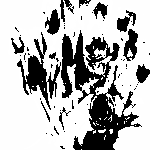

labels shape ⚡⚡⚡⚡ (22500, 1)


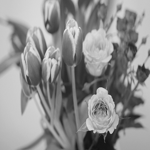

1


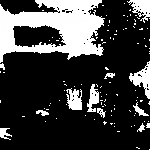

labels shape ⚡⚡⚡⚡ (22500, 1)


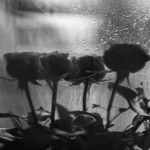

2


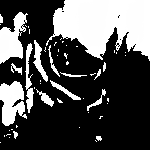

labels shape ⚡⚡⚡⚡ (22500, 1)


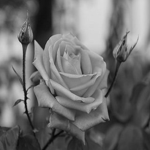

3


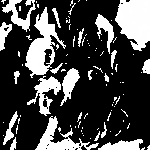

labels shape ⚡⚡⚡⚡ (22500, 1)


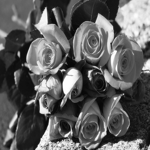

4


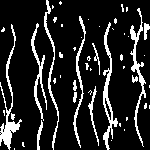

labels shape ⚡⚡⚡⚡ (22500, 1)


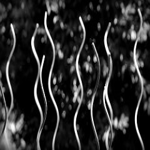

5


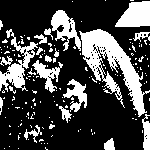

labels shape ⚡⚡⚡⚡ (22500, 1)


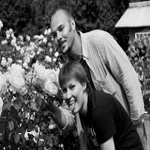

6


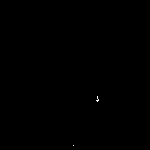

labels shape ⚡⚡⚡⚡ (22500, 1)


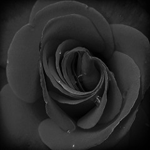

7


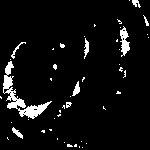

labels shape ⚡⚡⚡⚡ (22500, 1)


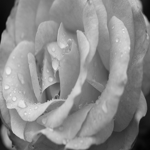

1 of total number of batches 98
<<✅✅✅epoc :  0  complete✅✅✅>>
 9484.659
logits shape ⚡⚡⚡⚡ (22500, 1)
0


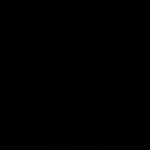

labels shape ⚡⚡⚡⚡ (22500, 1)


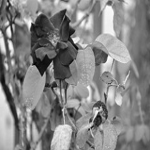

1


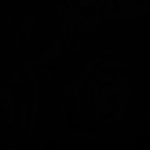

labels shape ⚡⚡⚡⚡ (22500, 1)


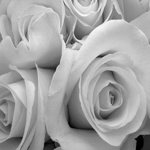

2


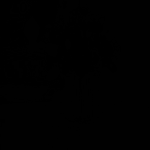

labels shape ⚡⚡⚡⚡ (22500, 1)


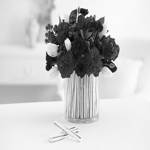

3


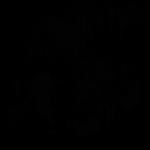

labels shape ⚡⚡⚡⚡ (22500, 1)


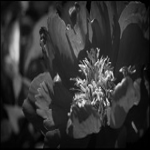

4


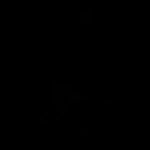

labels shape ⚡⚡⚡⚡ (22500, 1)


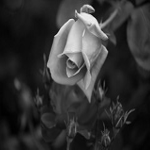

5


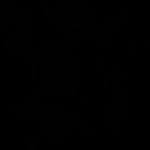

labels shape ⚡⚡⚡⚡ (22500, 1)


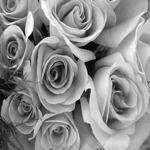

6


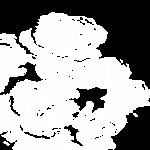

labels shape ⚡⚡⚡⚡ (22500, 1)


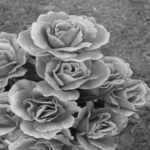

7


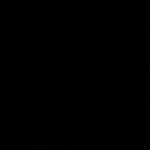

labels shape ⚡⚡⚡⚡ (22500, 1)


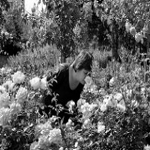

2 of total number of batches 98
<<✅✅✅epoc :  0  complete✅✅✅>>
 7757.6284
logits shape ⚡⚡⚡⚡ (22500, 1)
0


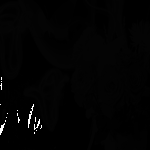

labels shape ⚡⚡⚡⚡ (22500, 1)


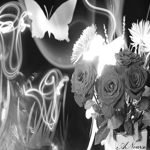

1


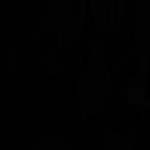

labels shape ⚡⚡⚡⚡ (22500, 1)


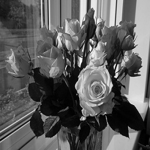

2


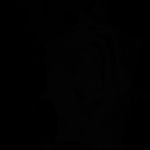

labels shape ⚡⚡⚡⚡ (22500, 1)


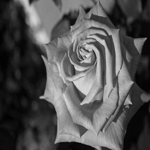

3


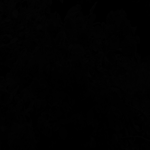

labels shape ⚡⚡⚡⚡ (22500, 1)


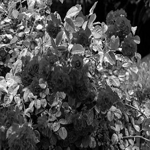

4


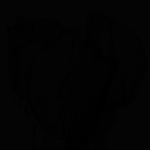

labels shape ⚡⚡⚡⚡ (22500, 1)


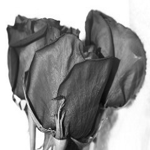

5


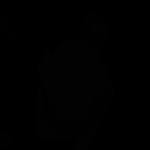

labels shape ⚡⚡⚡⚡ (22500, 1)


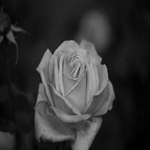

6


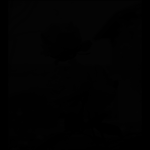

labels shape ⚡⚡⚡⚡ (22500, 1)


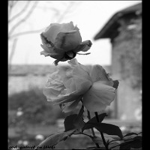

7


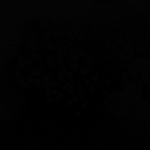

labels shape ⚡⚡⚡⚡ (22500, 1)


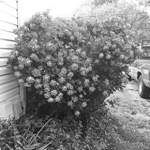

3 of total number of batches 98
<<✅✅✅epoc :  0  complete✅✅✅>>
 6180.8706
logits shape ⚡⚡⚡⚡ (22500, 1)
0


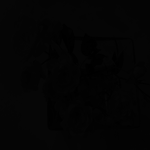

labels shape ⚡⚡⚡⚡ (22500, 1)


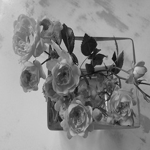

1


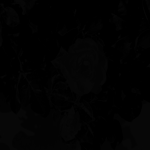

labels shape ⚡⚡⚡⚡ (22500, 1)


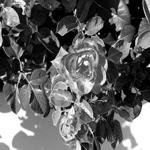

2


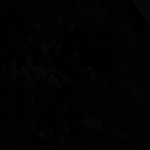

labels shape ⚡⚡⚡⚡ (22500, 1)


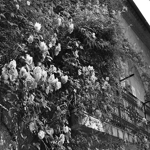

3


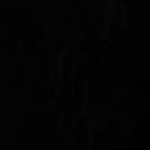

labels shape ⚡⚡⚡⚡ (22500, 1)


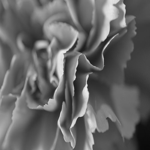

4


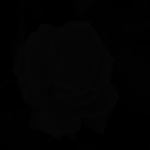

labels shape ⚡⚡⚡⚡ (22500, 1)


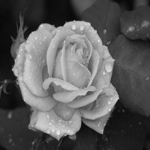

5


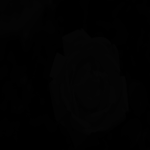

labels shape ⚡⚡⚡⚡ (22500, 1)


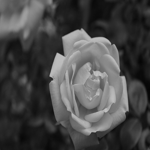

6


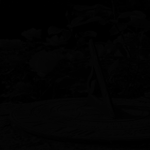

labels shape ⚡⚡⚡⚡ (22500, 1)


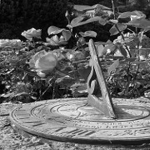

7


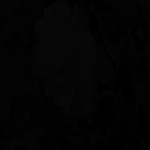

labels shape ⚡⚡⚡⚡ (22500, 1)


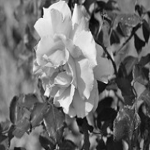

4 of total number of batches 98
<<✅✅✅epoc :  0  complete✅✅✅>>
 6674.0566
logits shape ⚡⚡⚡⚡ (22500, 1)
0


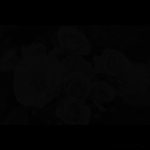

labels shape ⚡⚡⚡⚡ (22500, 1)


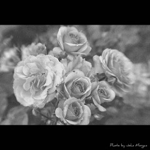

1


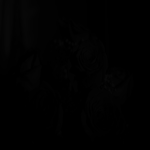

labels shape ⚡⚡⚡⚡ (22500, 1)


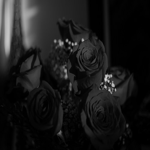

2


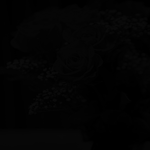

labels shape ⚡⚡⚡⚡ (22500, 1)


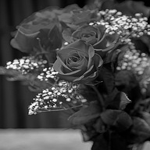

3


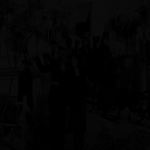

labels shape ⚡⚡⚡⚡ (22500, 1)


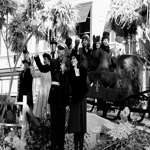

4


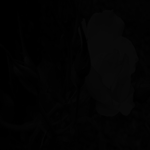

labels shape ⚡⚡⚡⚡ (22500, 1)


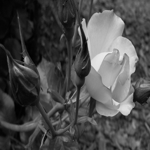

5


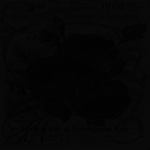

labels shape ⚡⚡⚡⚡ (22500, 1)


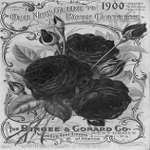

6


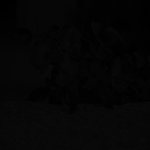

labels shape ⚡⚡⚡⚡ (22500, 1)


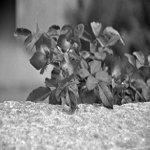

7


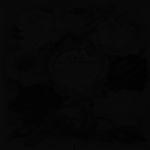

labels shape ⚡⚡⚡⚡ (22500, 1)


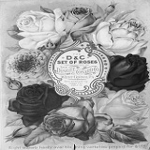

5 of total number of batches 98
<<✅✅✅epoc :  0  complete✅✅✅>>
 8455.321
logits shape ⚡⚡⚡⚡ (22500, 1)
0


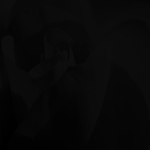

labels shape ⚡⚡⚡⚡ (22500, 1)


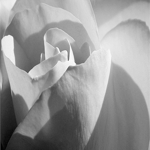

1


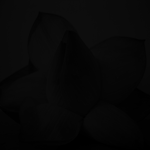

labels shape ⚡⚡⚡⚡ (22500, 1)


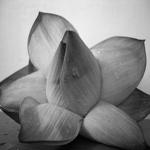

2


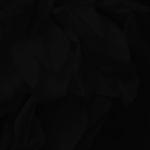

labels shape ⚡⚡⚡⚡ (22500, 1)


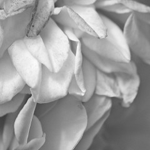

3


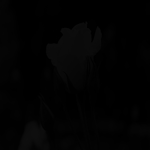

labels shape ⚡⚡⚡⚡ (22500, 1)


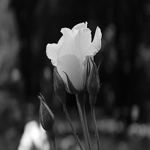

4


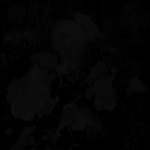

labels shape ⚡⚡⚡⚡ (22500, 1)


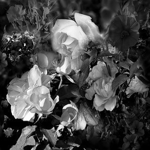

5


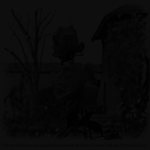

labels shape ⚡⚡⚡⚡ (22500, 1)


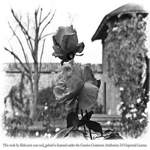

6


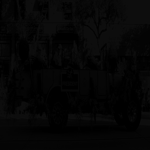

labels shape ⚡⚡⚡⚡ (22500, 1)


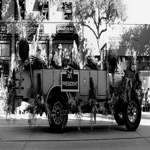

7


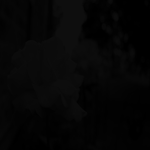

labels shape ⚡⚡⚡⚡ (22500, 1)


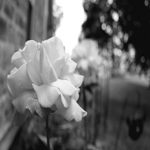

6 of total number of batches 98
<<✅✅✅epoc :  0  complete✅✅✅>>
 8158.5664
logits shape ⚡⚡⚡⚡ (22500, 1)
0


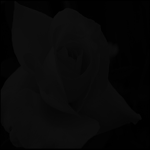

labels shape ⚡⚡⚡⚡ (22500, 1)


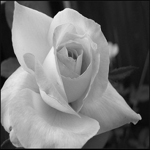

1


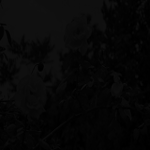

labels shape ⚡⚡⚡⚡ (22500, 1)


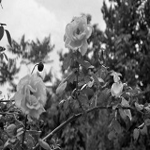

2


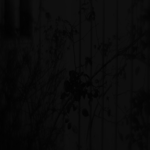

labels shape ⚡⚡⚡⚡ (22500, 1)


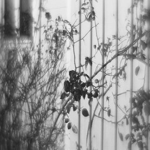

3


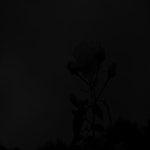

labels shape ⚡⚡⚡⚡ (22500, 1)


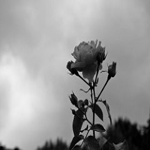

4


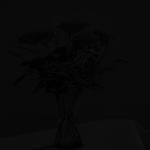

labels shape ⚡⚡⚡⚡ (22500, 1)


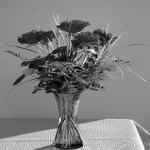

5


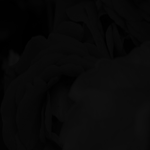

labels shape ⚡⚡⚡⚡ (22500, 1)


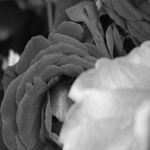

6


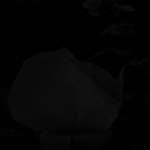

labels shape ⚡⚡⚡⚡ (22500, 1)


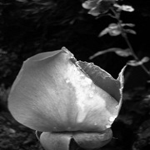

7


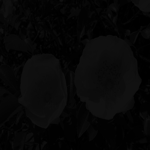

labels shape ⚡⚡⚡⚡ (22500, 1)


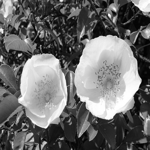

7 of total number of batches 98
<<✅✅✅epoc :  0  complete✅✅✅>>
 10230.328
logits shape ⚡⚡⚡⚡ (22500, 1)
0


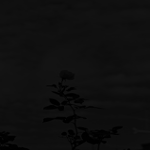

labels shape ⚡⚡⚡⚡ (22500, 1)


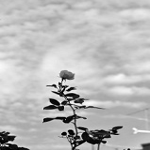

1


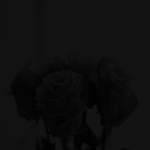

labels shape ⚡⚡⚡⚡ (22500, 1)


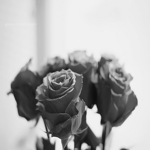

2


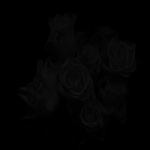

labels shape ⚡⚡⚡⚡ (22500, 1)


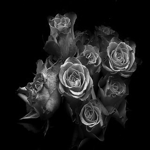

3


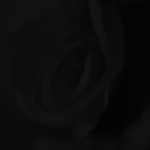

labels shape ⚡⚡⚡⚡ (22500, 1)


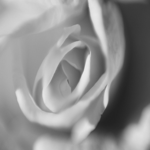

4


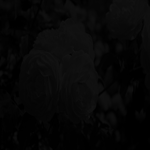

labels shape ⚡⚡⚡⚡ (22500, 1)


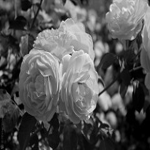

5


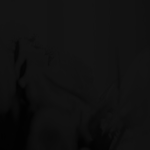

labels shape ⚡⚡⚡⚡ (22500, 1)


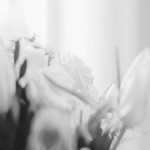

6


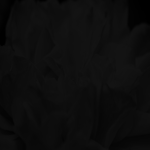

labels shape ⚡⚡⚡⚡ (22500, 1)


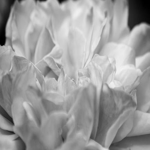

7


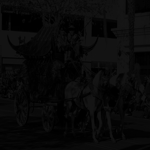

labels shape ⚡⚡⚡⚡ (22500, 1)


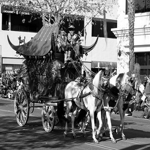

8 of total number of batches 98
<<✅✅✅epoc :  0  complete✅✅✅>>
 4300.002
logits shape ⚡⚡⚡⚡ (22500, 1)
0


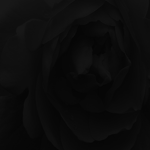

labels shape ⚡⚡⚡⚡ (22500, 1)


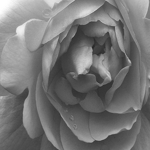

1


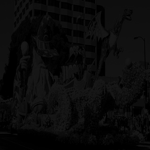

labels shape ⚡⚡⚡⚡ (22500, 1)


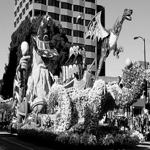

2


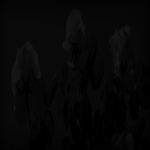

labels shape ⚡⚡⚡⚡ (22500, 1)


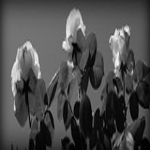

3


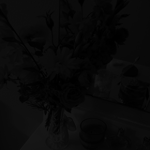

labels shape ⚡⚡⚡⚡ (22500, 1)


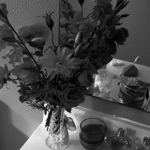

4


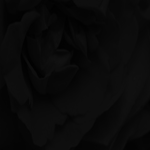

labels shape ⚡⚡⚡⚡ (22500, 1)


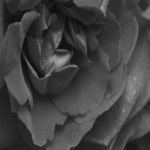

5


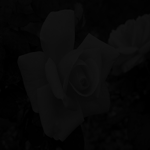

labels shape ⚡⚡⚡⚡ (22500, 1)


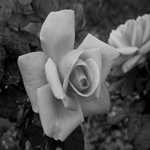

6


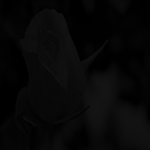

labels shape ⚡⚡⚡⚡ (22500, 1)


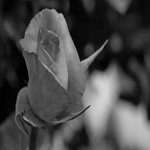

7


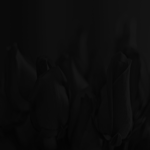

labels shape ⚡⚡⚡⚡ (22500, 1)


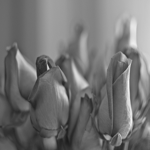

9 of total number of batches 98
<<✅✅✅epoc :  0  complete✅✅✅>>
 4823.598
logits shape ⚡⚡⚡⚡ (22500, 1)
0


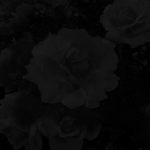

labels shape ⚡⚡⚡⚡ (22500, 1)


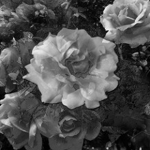

1


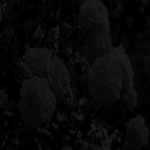

labels shape ⚡⚡⚡⚡ (22500, 1)


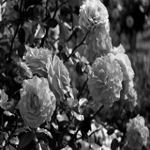

2


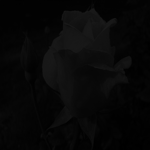

labels shape ⚡⚡⚡⚡ (22500, 1)


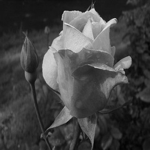

3


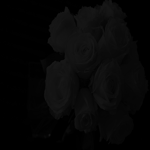

labels shape ⚡⚡⚡⚡ (22500, 1)


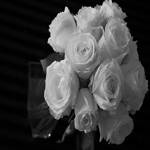

4


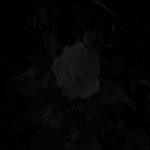

labels shape ⚡⚡⚡⚡ (22500, 1)


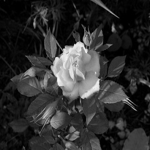

5


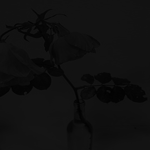

labels shape ⚡⚡⚡⚡ (22500, 1)


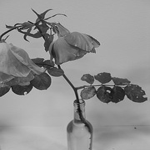

6


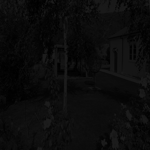

labels shape ⚡⚡⚡⚡ (22500, 1)


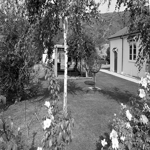

7


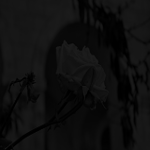

labels shape ⚡⚡⚡⚡ (22500, 1)


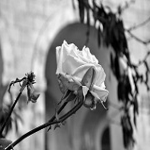

10 of total number of batches 98
<<✅✅✅epoc :  0  complete✅✅✅>>
 6663.666
logits shape ⚡⚡⚡⚡ (22500, 1)
0


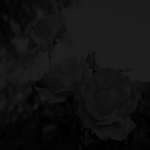

labels shape ⚡⚡⚡⚡ (22500, 1)


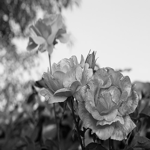

1


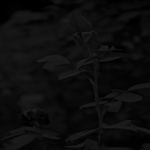

labels shape ⚡⚡⚡⚡ (22500, 1)


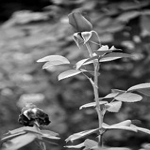

2


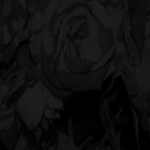

labels shape ⚡⚡⚡⚡ (22500, 1)


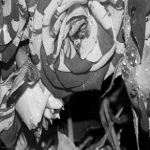

3


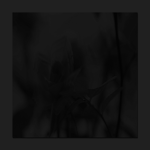

labels shape ⚡⚡⚡⚡ (22500, 1)


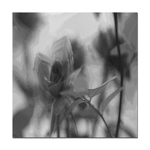

4


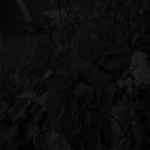

labels shape ⚡⚡⚡⚡ (22500, 1)


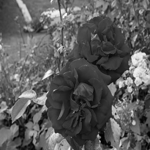

5


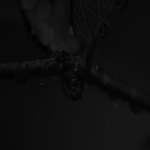

labels shape ⚡⚡⚡⚡ (22500, 1)


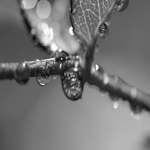

6


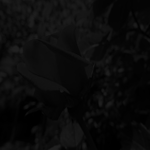

labels shape ⚡⚡⚡⚡ (22500, 1)


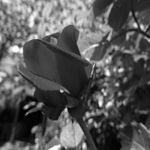

7


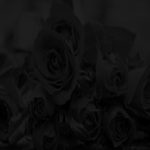

labels shape ⚡⚡⚡⚡ (22500, 1)


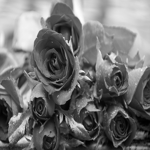

11 of total number of batches 98
<<✅✅✅epoc :  0  complete✅✅✅>>
 5536.9824
logits shape ⚡⚡⚡⚡ (22500, 1)
0


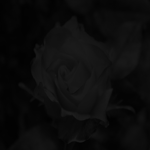

labels shape ⚡⚡⚡⚡ (22500, 1)


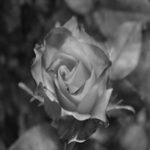

1


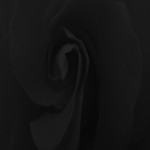

labels shape ⚡⚡⚡⚡ (22500, 1)


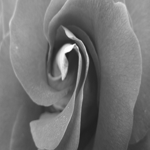

2


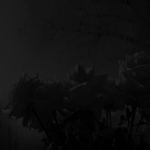

labels shape ⚡⚡⚡⚡ (22500, 1)


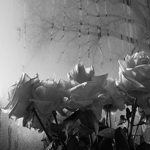

3


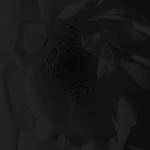

labels shape ⚡⚡⚡⚡ (22500, 1)


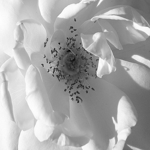

4


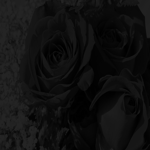

labels shape ⚡⚡⚡⚡ (22500, 1)


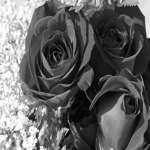

5


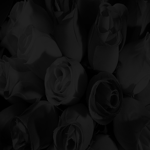

labels shape ⚡⚡⚡⚡ (22500, 1)


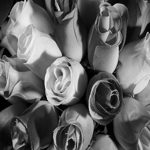

6


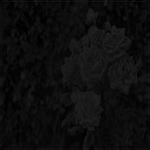

labels shape ⚡⚡⚡⚡ (22500, 1)


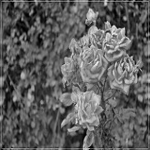

7


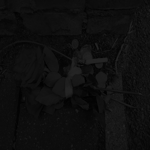

labels shape ⚡⚡⚡⚡ (22500, 1)


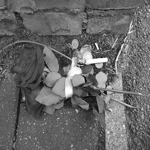

12 of total number of batches 98
<<✅✅✅epoc :  0  complete✅✅✅>>
 4945.3955
logits shape ⚡⚡⚡⚡ (22500, 1)
0


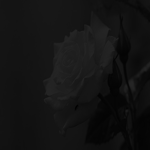

labels shape ⚡⚡⚡⚡ (22500, 1)


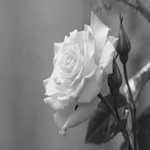

1


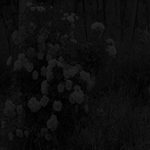

labels shape ⚡⚡⚡⚡ (22500, 1)


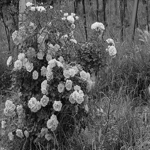

2


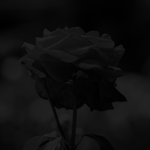

labels shape ⚡⚡⚡⚡ (22500, 1)


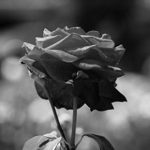

3


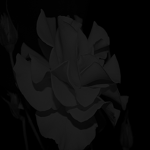

labels shape ⚡⚡⚡⚡ (22500, 1)


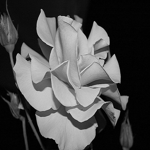

4


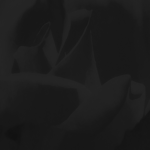

labels shape ⚡⚡⚡⚡ (22500, 1)


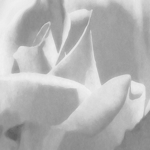

5


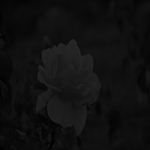

labels shape ⚡⚡⚡⚡ (22500, 1)


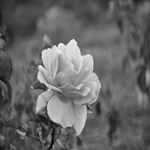

6


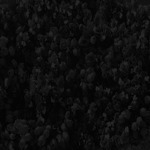

labels shape ⚡⚡⚡⚡ (22500, 1)


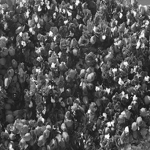

7


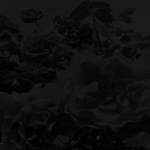

labels shape ⚡⚡⚡⚡ (22500, 1)


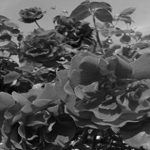

13 of total number of batches 98
<<✅✅✅epoc :  0  complete✅✅✅>>
 4017.1187
logits shape ⚡⚡⚡⚡ (22500, 1)
0


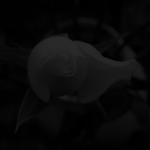

labels shape ⚡⚡⚡⚡ (22500, 1)


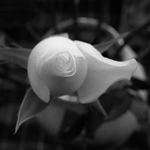

1


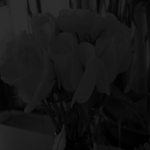

labels shape ⚡⚡⚡⚡ (22500, 1)


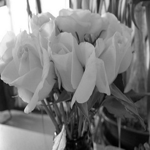

2


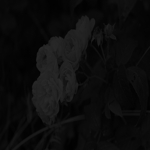

labels shape ⚡⚡⚡⚡ (22500, 1)


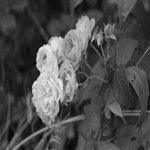

3


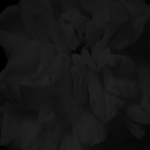

labels shape ⚡⚡⚡⚡ (22500, 1)


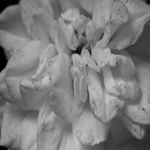

4


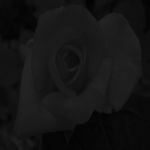

labels shape ⚡⚡⚡⚡ (22500, 1)


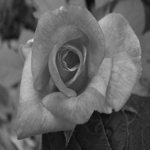

5


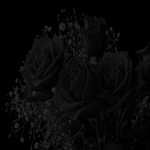

labels shape ⚡⚡⚡⚡ (22500, 1)


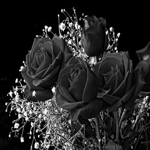

6


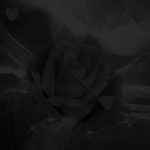

labels shape ⚡⚡⚡⚡ (22500, 1)


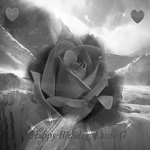

7


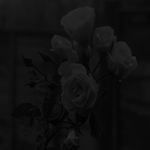

labels shape ⚡⚡⚡⚡ (22500, 1)


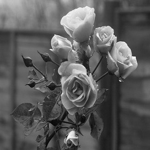

14 of total number of batches 98
<<✅✅✅epoc :  0  complete✅✅✅>>
 5347.0874
logits shape ⚡⚡⚡⚡ (22500, 1)
0


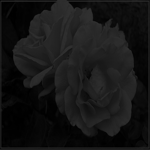

labels shape ⚡⚡⚡⚡ (22500, 1)


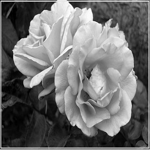

1


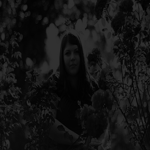

labels shape ⚡⚡⚡⚡ (22500, 1)


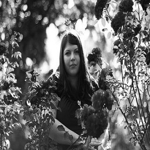

2


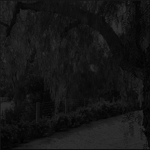

labels shape ⚡⚡⚡⚡ (22500, 1)


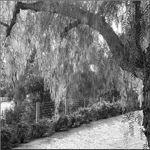

3


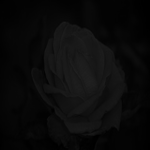

labels shape ⚡⚡⚡⚡ (22500, 1)


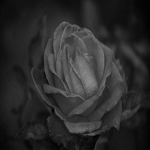

4


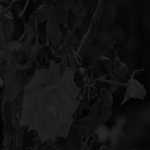

labels shape ⚡⚡⚡⚡ (22500, 1)


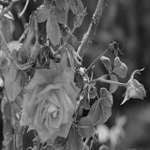

5


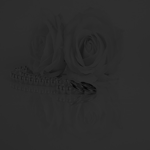

labels shape ⚡⚡⚡⚡ (22500, 1)


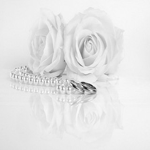

6


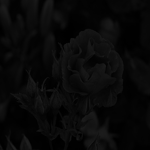

labels shape ⚡⚡⚡⚡ (22500, 1)


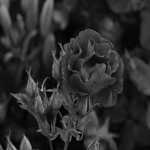

7


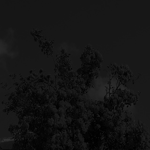

labels shape ⚡⚡⚡⚡ (22500, 1)


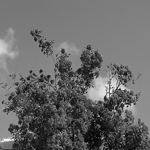

15 of total number of batches 98
<<✅✅✅epoc :  0  complete✅✅✅>>
 4609.008
logits shape ⚡⚡⚡⚡ (22500, 1)
0


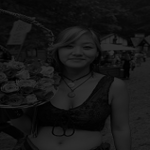

labels shape ⚡⚡⚡⚡ (22500, 1)


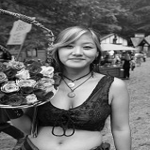

1


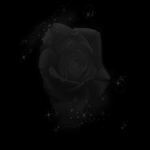

labels shape ⚡⚡⚡⚡ (22500, 1)


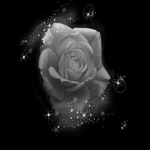

2


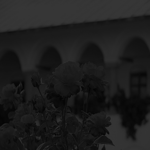

labels shape ⚡⚡⚡⚡ (22500, 1)


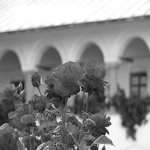

3


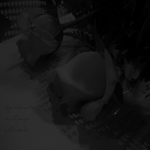

labels shape ⚡⚡⚡⚡ (22500, 1)


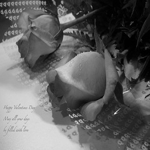

4


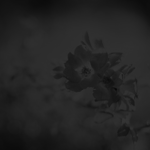

labels shape ⚡⚡⚡⚡ (22500, 1)


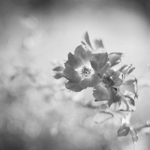

5


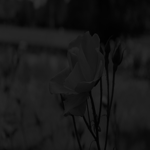

labels shape ⚡⚡⚡⚡ (22500, 1)


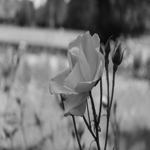

6


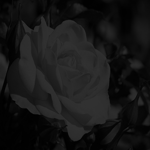

labels shape ⚡⚡⚡⚡ (22500, 1)


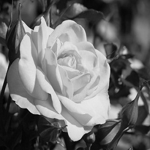

7


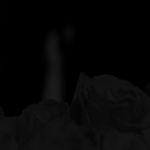

labels shape ⚡⚡⚡⚡ (22500, 1)


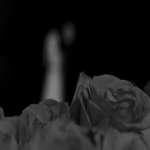

16 of total number of batches 98
<<✅✅✅epoc :  0  complete✅✅✅>>
 3447.4102
logits shape ⚡⚡⚡⚡ (22500, 1)
0


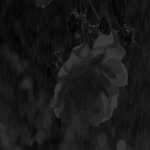

labels shape ⚡⚡⚡⚡ (22500, 1)


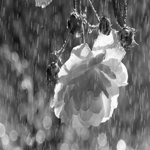

1


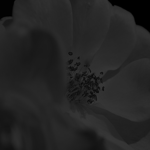

labels shape ⚡⚡⚡⚡ (22500, 1)


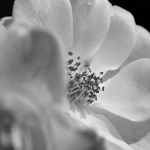

2


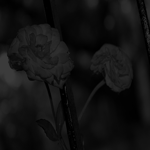

labels shape ⚡⚡⚡⚡ (22500, 1)


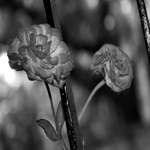

3


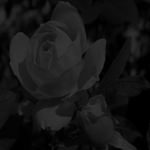

labels shape ⚡⚡⚡⚡ (22500, 1)


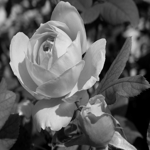

4


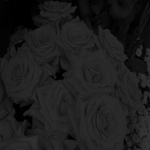

labels shape ⚡⚡⚡⚡ (22500, 1)


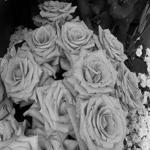

5


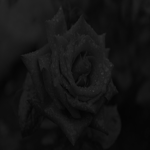

labels shape ⚡⚡⚡⚡ (22500, 1)


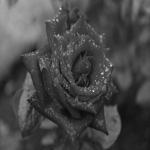

6


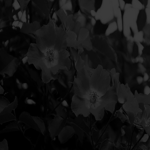

labels shape ⚡⚡⚡⚡ (22500, 1)


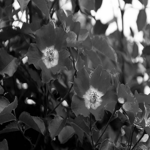

7


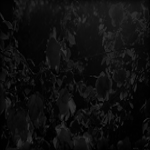

labels shape ⚡⚡⚡⚡ (22500, 1)


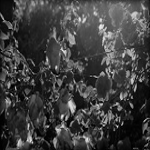

17 of total number of batches 98
<<✅✅✅epoc :  0  complete✅✅✅>>
 4512.1123
logits shape ⚡⚡⚡⚡ (22500, 1)
0


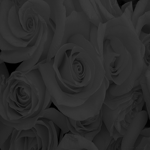

labels shape ⚡⚡⚡⚡ (22500, 1)


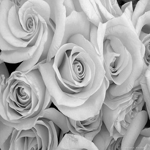

1


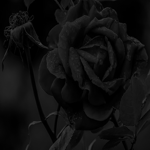

labels shape ⚡⚡⚡⚡ (22500, 1)


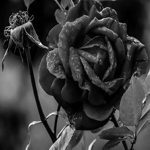

2


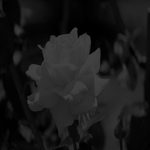

labels shape ⚡⚡⚡⚡ (22500, 1)


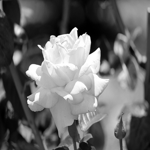

3


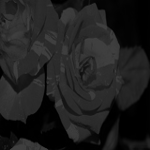

labels shape ⚡⚡⚡⚡ (22500, 1)


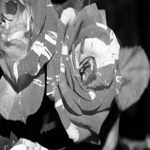

4


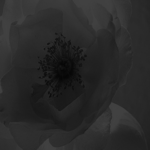

labels shape ⚡⚡⚡⚡ (22500, 1)


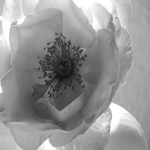

5


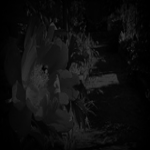

labels shape ⚡⚡⚡⚡ (22500, 1)


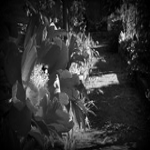

6


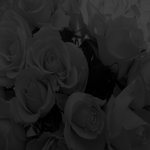

labels shape ⚡⚡⚡⚡ (22500, 1)


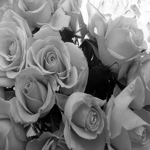

7


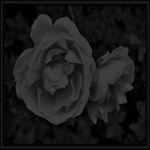

labels shape ⚡⚡⚡⚡ (22500, 1)


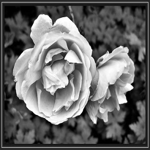

18 of total number of batches 98
<<✅✅✅epoc :  0  complete✅✅✅>>
 3404.2249
logits shape ⚡⚡⚡⚡ (22500, 1)
0


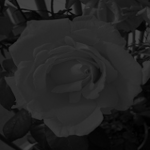

labels shape ⚡⚡⚡⚡ (22500, 1)


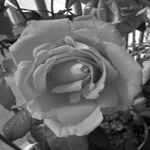

1


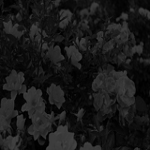

labels shape ⚡⚡⚡⚡ (22500, 1)


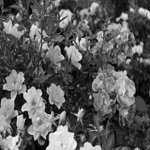

2


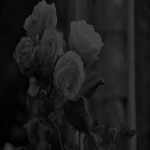

labels shape ⚡⚡⚡⚡ (22500, 1)


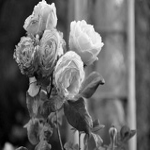

3


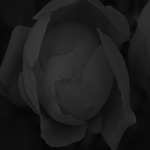

labels shape ⚡⚡⚡⚡ (22500, 1)


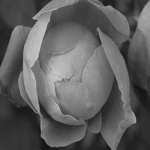

4


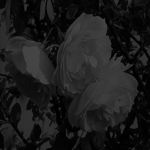

labels shape ⚡⚡⚡⚡ (22500, 1)


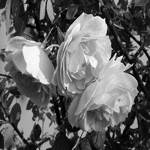

5


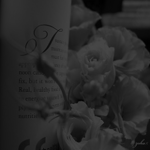

labels shape ⚡⚡⚡⚡ (22500, 1)


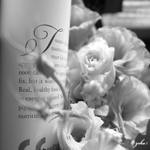

6


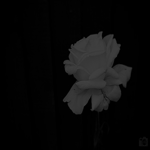

labels shape ⚡⚡⚡⚡ (22500, 1)


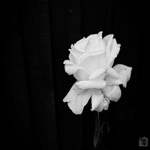

7


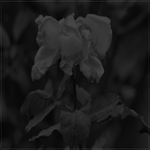

labels shape ⚡⚡⚡⚡ (22500, 1)


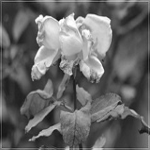

19 of total number of batches 98
<<✅✅✅epoc :  0  complete✅✅✅>>
 2868.5686
logits shape ⚡⚡⚡⚡ (22500, 1)
0


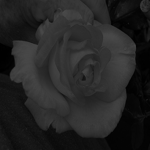

labels shape ⚡⚡⚡⚡ (22500, 1)


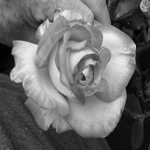

1


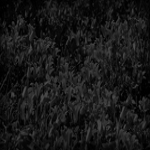

labels shape ⚡⚡⚡⚡ (22500, 1)


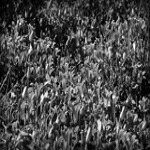

2


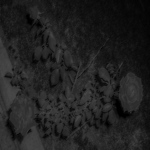

labels shape ⚡⚡⚡⚡ (22500, 1)


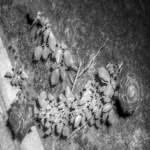

3


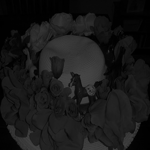

labels shape ⚡⚡⚡⚡ (22500, 1)


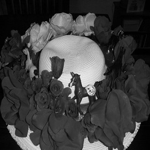

4


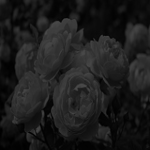

labels shape ⚡⚡⚡⚡ (22500, 1)


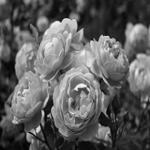

5


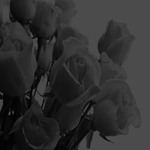

labels shape ⚡⚡⚡⚡ (22500, 1)


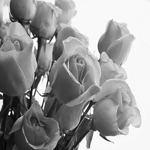

6


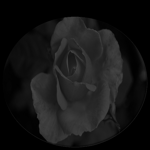

labels shape ⚡⚡⚡⚡ (22500, 1)


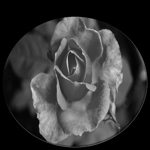

7


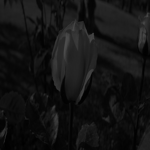

labels shape ⚡⚡⚡⚡ (22500, 1)


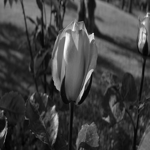

20 of total number of batches 98
<<✅✅✅epoc :  0  complete✅✅✅>>
 3635.3733
logits shape ⚡⚡⚡⚡ (22500, 1)
0


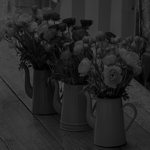

labels shape ⚡⚡⚡⚡ (22500, 1)


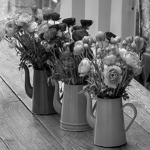

1


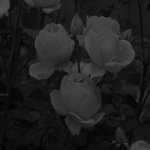

labels shape ⚡⚡⚡⚡ (22500, 1)


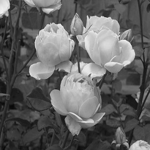

2


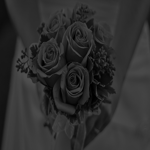

labels shape ⚡⚡⚡⚡ (22500, 1)


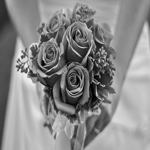

3


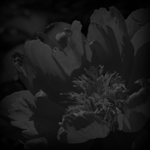

labels shape ⚡⚡⚡⚡ (22500, 1)


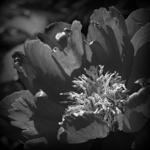

4


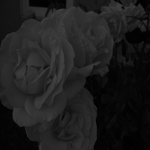

labels shape ⚡⚡⚡⚡ (22500, 1)


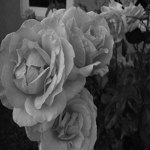

5


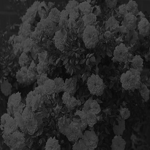

labels shape ⚡⚡⚡⚡ (22500, 1)


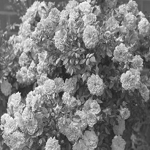

6


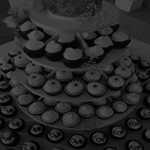

labels shape ⚡⚡⚡⚡ (22500, 1)


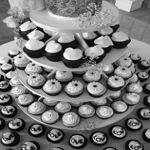

7


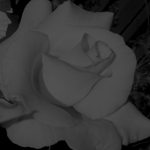

labels shape ⚡⚡⚡⚡ (22500, 1)


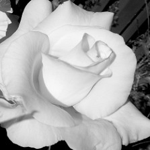

21 of total number of batches 98
<<✅✅✅epoc :  0  complete✅✅✅>>
 3221.499
logits shape ⚡⚡⚡⚡ (22500, 1)
0


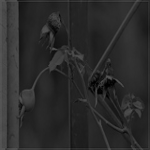

labels shape ⚡⚡⚡⚡ (22500, 1)


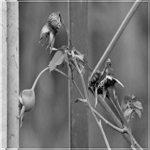

1


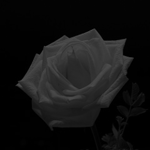

labels shape ⚡⚡⚡⚡ (22500, 1)


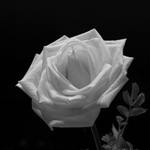

2


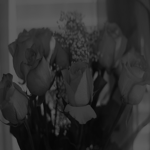

labels shape ⚡⚡⚡⚡ (22500, 1)


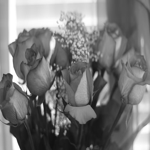

3


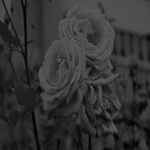

labels shape ⚡⚡⚡⚡ (22500, 1)


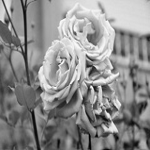

4


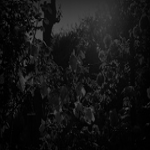

labels shape ⚡⚡⚡⚡ (22500, 1)


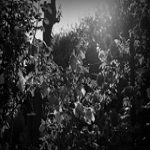

5


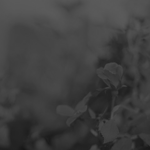

labels shape ⚡⚡⚡⚡ (22500, 1)


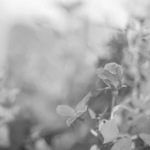

6


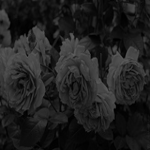

labels shape ⚡⚡⚡⚡ (22500, 1)


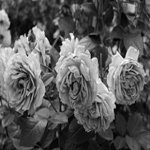

7


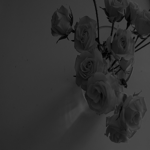

labels shape ⚡⚡⚡⚡ (22500, 1)


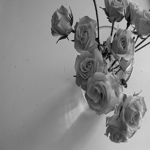

22 of total number of batches 98
<<✅✅✅epoc :  0  complete✅✅✅>>
 2323.6633
logits shape ⚡⚡⚡⚡ (22500, 1)
0


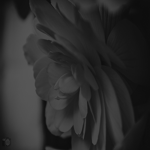

labels shape ⚡⚡⚡⚡ (22500, 1)


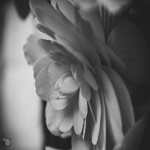

1


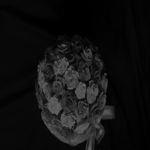

labels shape ⚡⚡⚡⚡ (22500, 1)


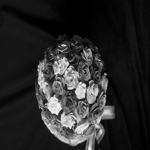

2


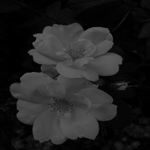

labels shape ⚡⚡⚡⚡ (22500, 1)


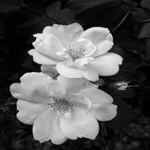

3


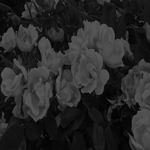

labels shape ⚡⚡⚡⚡ (22500, 1)


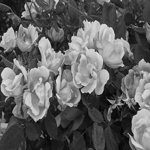

4


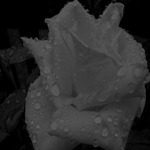

labels shape ⚡⚡⚡⚡ (22500, 1)


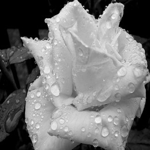

5


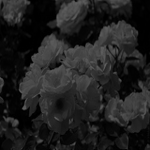

labels shape ⚡⚡⚡⚡ (22500, 1)


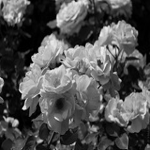

6


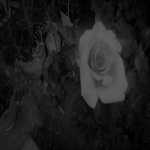

labels shape ⚡⚡⚡⚡ (22500, 1)


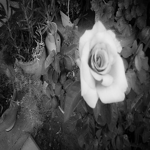

7


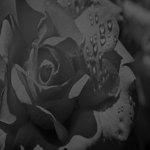

labels shape ⚡⚡⚡⚡ (22500, 1)


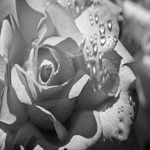

23 of total number of batches 98
<<✅✅✅epoc :  0  complete✅✅✅>>
 1657.4395
logits shape ⚡⚡⚡⚡ (22500, 1)
0


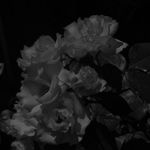

labels shape ⚡⚡⚡⚡ (22500, 1)


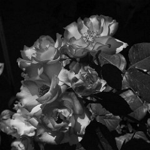

1


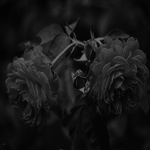

labels shape ⚡⚡⚡⚡ (22500, 1)


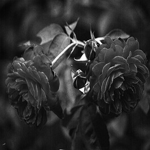

2


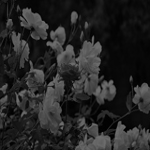

labels shape ⚡⚡⚡⚡ (22500, 1)


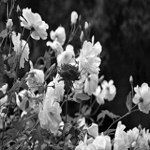

3


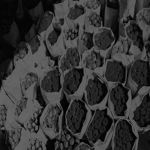

labels shape ⚡⚡⚡⚡ (22500, 1)


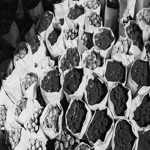

4


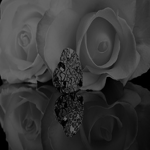

labels shape ⚡⚡⚡⚡ (22500, 1)


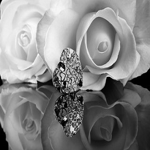

5


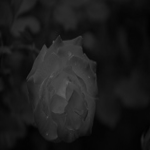

labels shape ⚡⚡⚡⚡ (22500, 1)


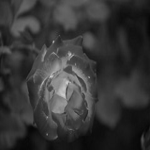

6


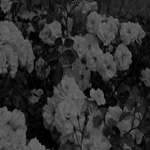

labels shape ⚡⚡⚡⚡ (22500, 1)


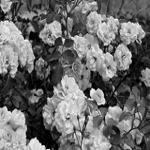

7


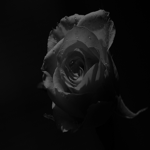

labels shape ⚡⚡⚡⚡ (22500, 1)


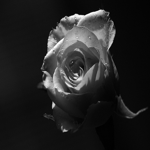

24 of total number of batches 98
<<✅✅✅epoc :  0  complete✅✅✅>>
 1825.8716
logits shape ⚡⚡⚡⚡ (22500, 1)
0


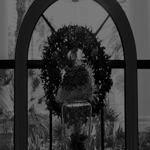

labels shape ⚡⚡⚡⚡ (22500, 1)


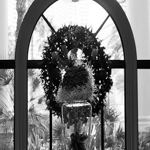

1


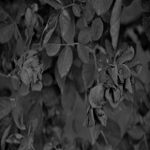

labels shape ⚡⚡⚡⚡ (22500, 1)


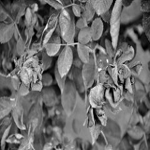

2


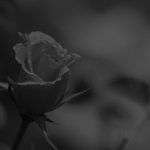

labels shape ⚡⚡⚡⚡ (22500, 1)


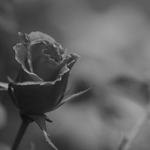

3


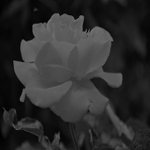

labels shape ⚡⚡⚡⚡ (22500, 1)


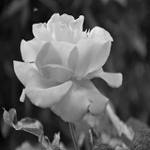

4


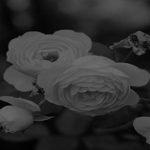

labels shape ⚡⚡⚡⚡ (22500, 1)


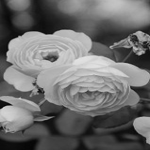

5


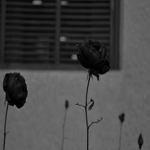

labels shape ⚡⚡⚡⚡ (22500, 1)


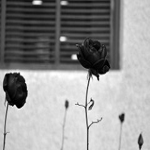

6


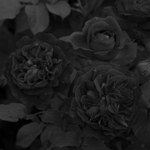

labels shape ⚡⚡⚡⚡ (22500, 1)


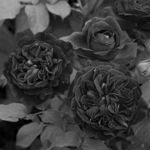

7


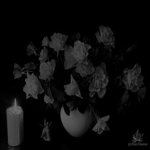

labels shape ⚡⚡⚡⚡ (22500, 1)


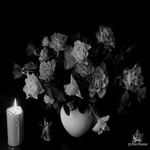

25 of total number of batches 98
<<✅✅✅epoc :  0  complete✅✅✅>>
 1470.5887
logits shape ⚡⚡⚡⚡ (22500, 1)
0


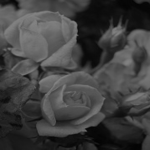

labels shape ⚡⚡⚡⚡ (22500, 1)


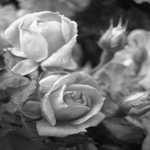

1


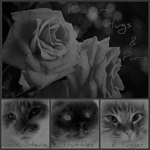

labels shape ⚡⚡⚡⚡ (22500, 1)


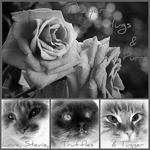

2


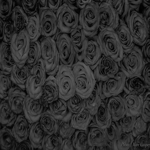

labels shape ⚡⚡⚡⚡ (22500, 1)


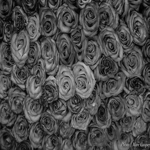

3


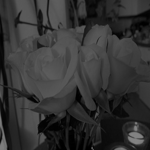

labels shape ⚡⚡⚡⚡ (22500, 1)


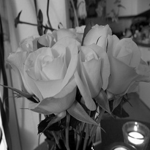

4


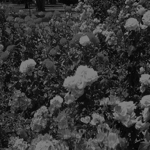

labels shape ⚡⚡⚡⚡ (22500, 1)


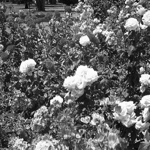

5


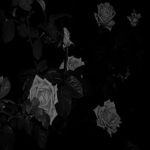

labels shape ⚡⚡⚡⚡ (22500, 1)


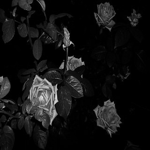

6


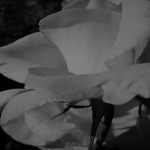

labels shape ⚡⚡⚡⚡ (22500, 1)


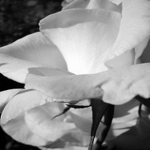

7


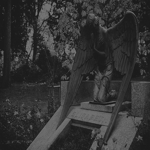

labels shape ⚡⚡⚡⚡ (22500, 1)


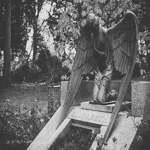

26 of total number of batches 98
<<✅✅✅epoc :  0  complete✅✅✅>>
 1152.0555
logits shape ⚡⚡⚡⚡ (22500, 1)
0


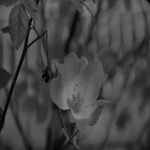

labels shape ⚡⚡⚡⚡ (22500, 1)


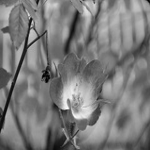

1


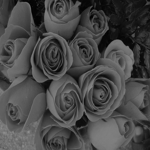

labels shape ⚡⚡⚡⚡ (22500, 1)


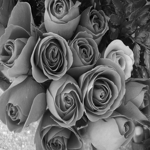

2


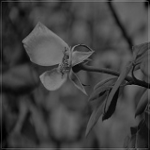

labels shape ⚡⚡⚡⚡ (22500, 1)


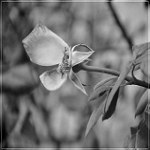

3


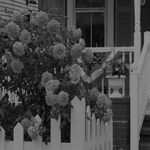

labels shape ⚡⚡⚡⚡ (22500, 1)


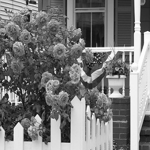

4


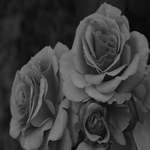

labels shape ⚡⚡⚡⚡ (22500, 1)


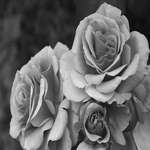

5


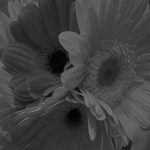

labels shape ⚡⚡⚡⚡ (22500, 1)


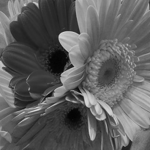

6


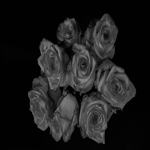

labels shape ⚡⚡⚡⚡ (22500, 1)


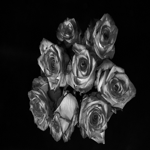

7


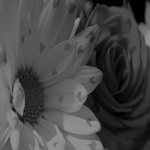

labels shape ⚡⚡⚡⚡ (22500, 1)


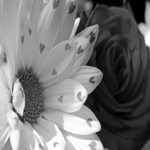

27 of total number of batches 98
<<✅✅✅epoc :  0  complete✅✅✅>>
 1167.2544
logits shape ⚡⚡⚡⚡ (22500, 1)
0


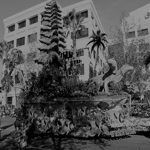

labels shape ⚡⚡⚡⚡ (22500, 1)


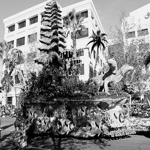

1


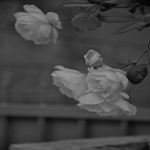

labels shape ⚡⚡⚡⚡ (22500, 1)


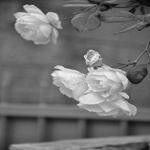

2


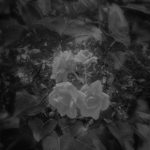

labels shape ⚡⚡⚡⚡ (22500, 1)


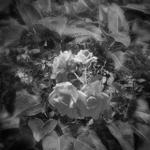

3


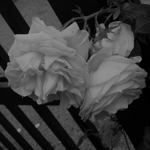

labels shape ⚡⚡⚡⚡ (22500, 1)


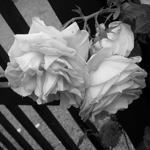

4


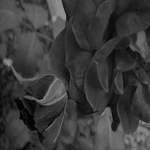

labels shape ⚡⚡⚡⚡ (22500, 1)


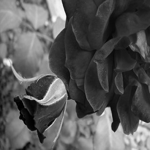

5


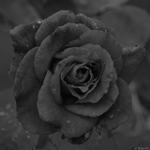

labels shape ⚡⚡⚡⚡ (22500, 1)


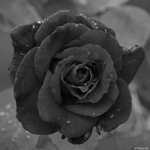

6


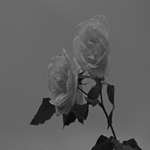

labels shape ⚡⚡⚡⚡ (22500, 1)


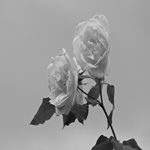

7


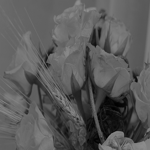

labels shape ⚡⚡⚡⚡ (22500, 1)


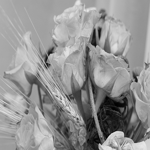

28 of total number of batches 98
<<✅✅✅epoc :  0  complete✅✅✅>>
 652.32477
logits shape ⚡⚡⚡⚡ (22500, 1)
0


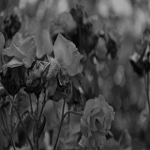

labels shape ⚡⚡⚡⚡ (22500, 1)


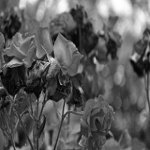

1


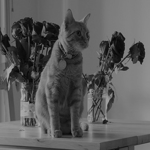

labels shape ⚡⚡⚡⚡ (22500, 1)


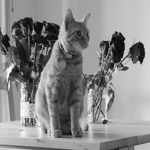

2


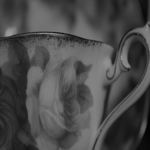

labels shape ⚡⚡⚡⚡ (22500, 1)


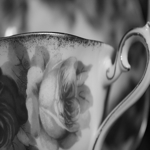

3


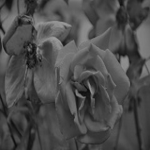

labels shape ⚡⚡⚡⚡ (22500, 1)


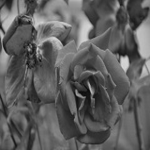

4


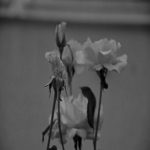

labels shape ⚡⚡⚡⚡ (22500, 1)


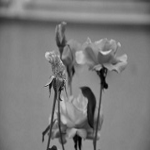

5


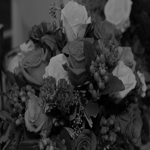

labels shape ⚡⚡⚡⚡ (22500, 1)


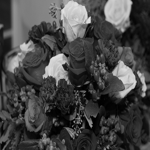

6


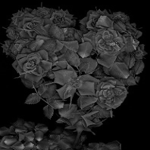

labels shape ⚡⚡⚡⚡ (22500, 1)


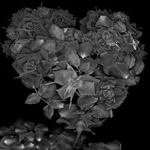

7


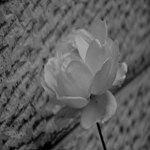

labels shape ⚡⚡⚡⚡ (22500, 1)


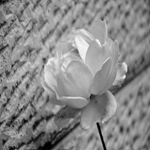

29 of total number of batches 98
<<✅✅✅epoc :  0  complete✅✅✅>>
 370.59305
logits shape ⚡⚡⚡⚡ (22500, 1)
0


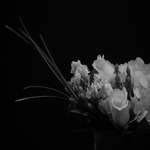

labels shape ⚡⚡⚡⚡ (22500, 1)


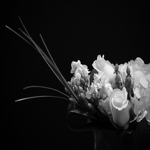

1


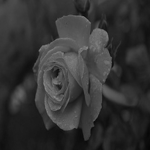

labels shape ⚡⚡⚡⚡ (22500, 1)


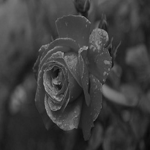

2


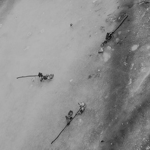

labels shape ⚡⚡⚡⚡ (22500, 1)


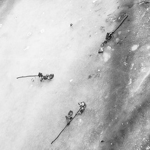

3


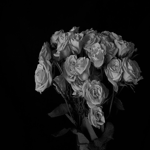

labels shape ⚡⚡⚡⚡ (22500, 1)


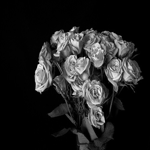

4


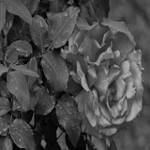

labels shape ⚡⚡⚡⚡ (22500, 1)


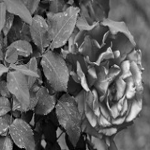

5


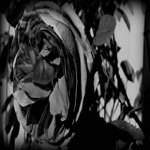

labels shape ⚡⚡⚡⚡ (22500, 1)


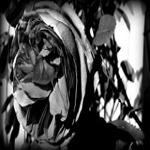

6


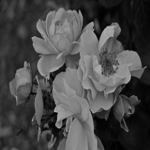

labels shape ⚡⚡⚡⚡ (22500, 1)


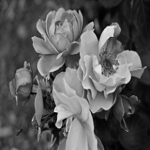

7


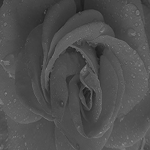

labels shape ⚡⚡⚡⚡ (22500, 1)


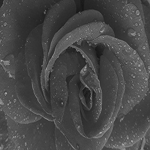

30 of total number of batches 98
<<✅✅✅epoc :  0  complete✅✅✅>>
 350.00803
logits shape ⚡⚡⚡⚡ (22500, 1)
0


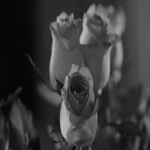

labels shape ⚡⚡⚡⚡ (22500, 1)


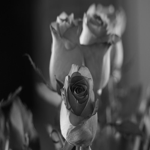

1


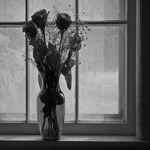

labels shape ⚡⚡⚡⚡ (22500, 1)


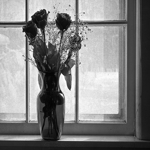

2


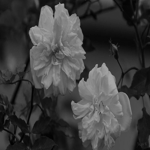

labels shape ⚡⚡⚡⚡ (22500, 1)


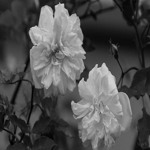

3


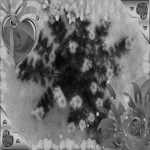

labels shape ⚡⚡⚡⚡ (22500, 1)


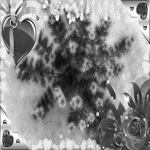

4


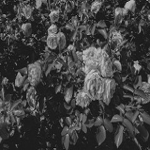

labels shape ⚡⚡⚡⚡ (22500, 1)


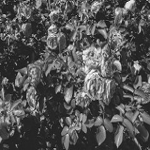

5


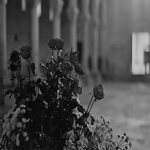

labels shape ⚡⚡⚡⚡ (22500, 1)


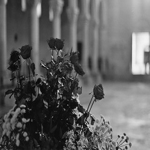

6


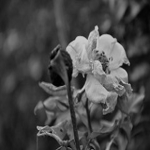

labels shape ⚡⚡⚡⚡ (22500, 1)


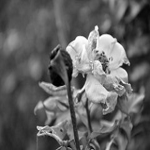

7


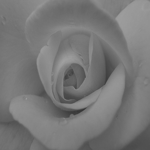

labels shape ⚡⚡⚡⚡ (22500, 1)


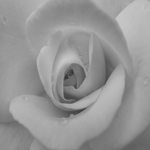

31 of total number of batches 98
<<✅✅✅epoc :  0  complete✅✅✅>>
 145.46574
logits shape ⚡⚡⚡⚡ (22500, 1)
0


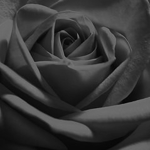

labels shape ⚡⚡⚡⚡ (22500, 1)


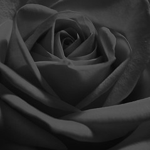

1


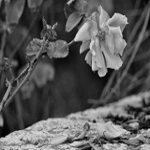

labels shape ⚡⚡⚡⚡ (22500, 1)


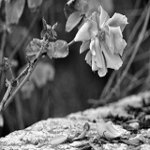

2


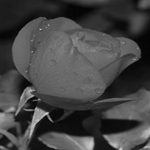

labels shape ⚡⚡⚡⚡ (22500, 1)


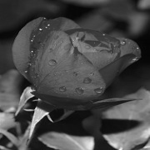

3


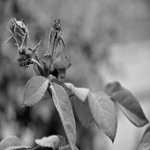

labels shape ⚡⚡⚡⚡ (22500, 1)


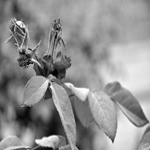

4


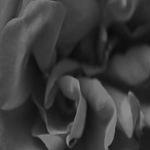

labels shape ⚡⚡⚡⚡ (22500, 1)


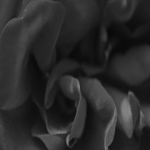

5


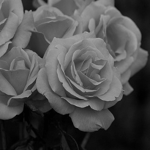

labels shape ⚡⚡⚡⚡ (22500, 1)


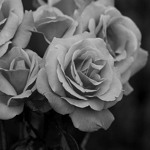

6


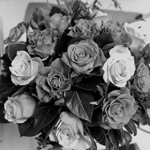

labels shape ⚡⚡⚡⚡ (22500, 1)


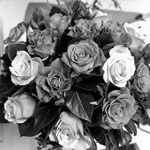

7


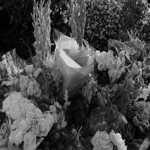

labels shape ⚡⚡⚡⚡ (22500, 1)


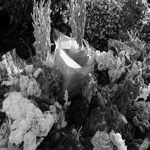

32 of total number of batches 98
<<✅✅✅epoc :  0  complete✅✅✅>>
 141.46713
logits shape ⚡⚡⚡⚡ (22500, 1)
0


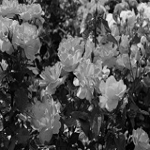

labels shape ⚡⚡⚡⚡ (22500, 1)


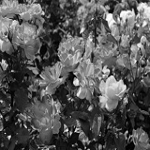

1


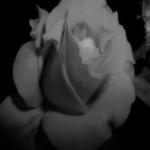

labels shape ⚡⚡⚡⚡ (22500, 1)


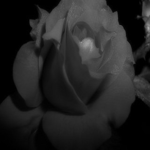

2


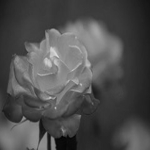

labels shape ⚡⚡⚡⚡ (22500, 1)


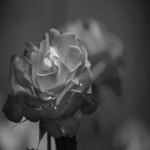

3


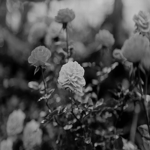

labels shape ⚡⚡⚡⚡ (22500, 1)


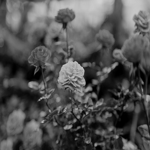

4


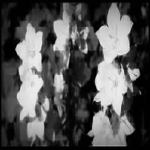

labels shape ⚡⚡⚡⚡ (22500, 1)


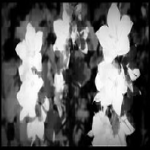

5


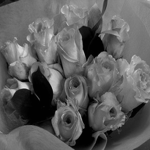

labels shape ⚡⚡⚡⚡ (22500, 1)


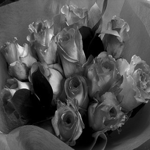

6


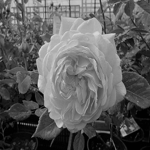

labels shape ⚡⚡⚡⚡ (22500, 1)


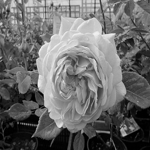

7


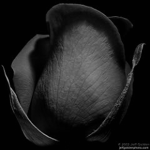

labels shape ⚡⚡⚡⚡ (22500, 1)


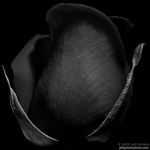

33 of total number of batches 98
<<✅✅✅epoc :  0  complete✅✅✅>>
 48.024555
logits shape ⚡⚡⚡⚡ (22500, 1)
0


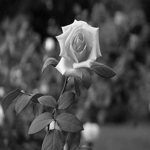

labels shape ⚡⚡⚡⚡ (22500, 1)


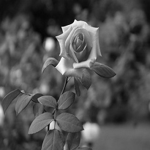

1


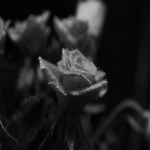

labels shape ⚡⚡⚡⚡ (22500, 1)


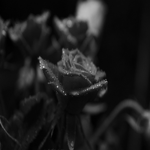

2


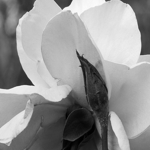

labels shape ⚡⚡⚡⚡ (22500, 1)


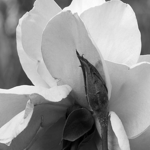

3


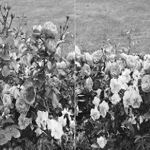

labels shape ⚡⚡⚡⚡ (22500, 1)


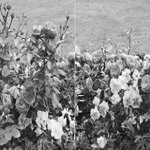

4


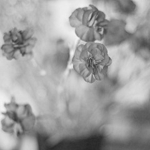

labels shape ⚡⚡⚡⚡ (22500, 1)


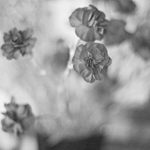

5


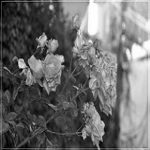

labels shape ⚡⚡⚡⚡ (22500, 1)


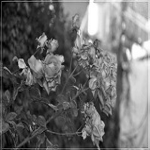

6


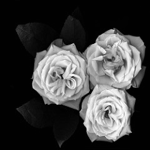

labels shape ⚡⚡⚡⚡ (22500, 1)


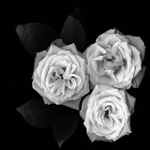

7


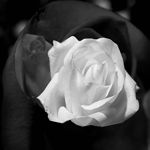

labels shape ⚡⚡⚡⚡ (22500, 1)


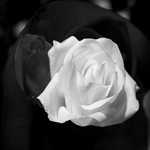

34 of total number of batches 98
<<✅✅✅epoc :  0  complete✅✅✅>>
 223.45535
logits shape ⚡⚡⚡⚡ (22500, 1)
0


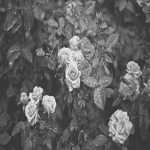

labels shape ⚡⚡⚡⚡ (22500, 1)


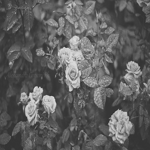

1


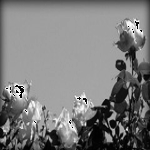

labels shape ⚡⚡⚡⚡ (22500, 1)


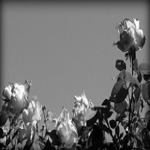

2


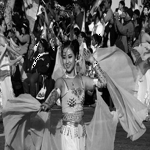

labels shape ⚡⚡⚡⚡ (22500, 1)


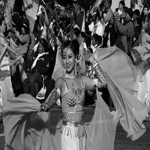

3


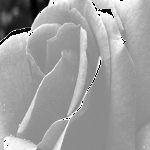

labels shape ⚡⚡⚡⚡ (22500, 1)


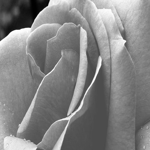

4


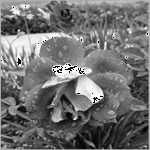

labels shape ⚡⚡⚡⚡ (22500, 1)


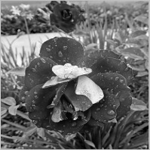

5


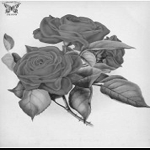

labels shape ⚡⚡⚡⚡ (22500, 1)


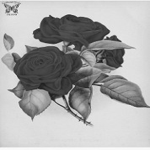

6


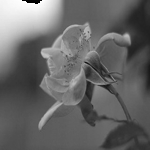

labels shape ⚡⚡⚡⚡ (22500, 1)


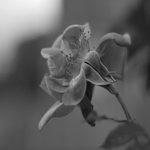

7


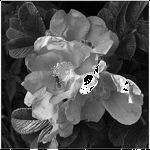

labels shape ⚡⚡⚡⚡ (22500, 1)


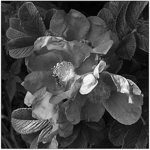

35 of total number of batches 98
<<✅✅✅epoc :  0  complete✅✅✅>>
 222.14838
logits shape ⚡⚡⚡⚡ (22500, 1)
0


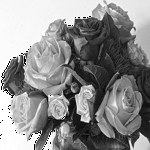

labels shape ⚡⚡⚡⚡ (22500, 1)


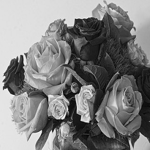

1


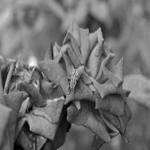

labels shape ⚡⚡⚡⚡ (22500, 1)


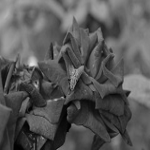

2


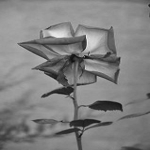

labels shape ⚡⚡⚡⚡ (22500, 1)


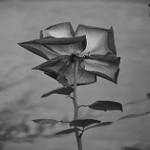

3


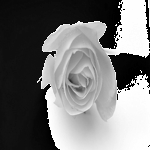

labels shape ⚡⚡⚡⚡ (22500, 1)


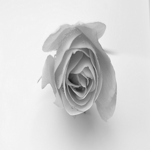

4


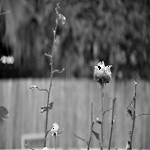

labels shape ⚡⚡⚡⚡ (22500, 1)


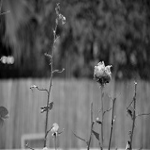

5


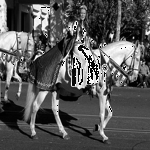

labels shape ⚡⚡⚡⚡ (22500, 1)


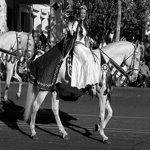

6


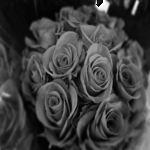

labels shape ⚡⚡⚡⚡ (22500, 1)


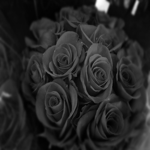

7


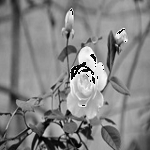

labels shape ⚡⚡⚡⚡ (22500, 1)


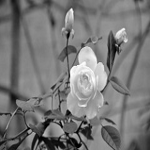

36 of total number of batches 98
<<✅✅✅epoc :  0  complete✅✅✅>>
 369.6317
logits shape ⚡⚡⚡⚡ (22500, 1)
0


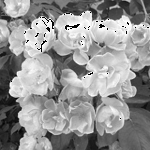

labels shape ⚡⚡⚡⚡ (22500, 1)


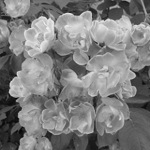

1


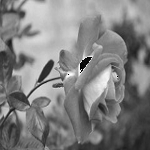

labels shape ⚡⚡⚡⚡ (22500, 1)


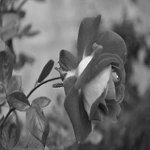

2


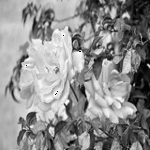

labels shape ⚡⚡⚡⚡ (22500, 1)


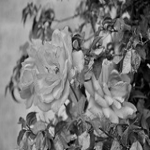

3


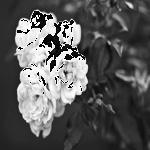

labels shape ⚡⚡⚡⚡ (22500, 1)


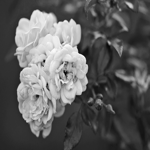

4


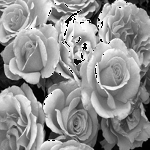

labels shape ⚡⚡⚡⚡ (22500, 1)


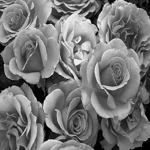

5


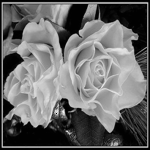

labels shape ⚡⚡⚡⚡ (22500, 1)


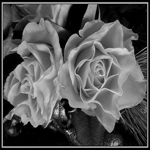

6


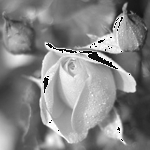

labels shape ⚡⚡⚡⚡ (22500, 1)


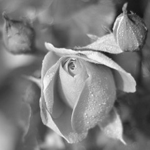

7


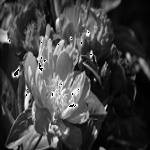

labels shape ⚡⚡⚡⚡ (22500, 1)


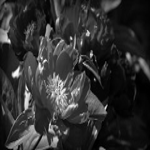

37 of total number of batches 98
<<✅✅✅epoc :  0  complete✅✅✅>>
 310.0922
logits shape ⚡⚡⚡⚡ (22500, 1)
0


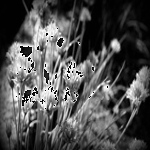

labels shape ⚡⚡⚡⚡ (22500, 1)


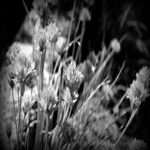

1


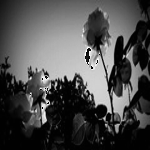

labels shape ⚡⚡⚡⚡ (22500, 1)


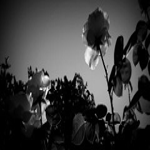

2


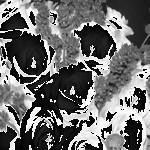

labels shape ⚡⚡⚡⚡ (22500, 1)


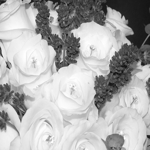

3


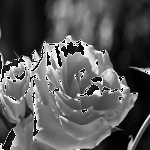

labels shape ⚡⚡⚡⚡ (22500, 1)


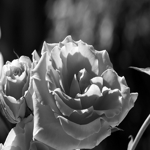

4


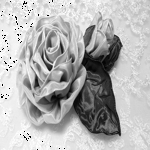

labels shape ⚡⚡⚡⚡ (22500, 1)


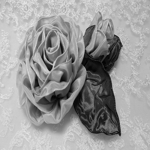

5


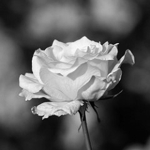

labels shape ⚡⚡⚡⚡ (22500, 1)


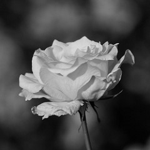

6


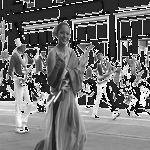

labels shape ⚡⚡⚡⚡ (22500, 1)


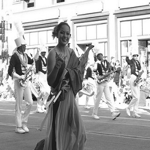

7


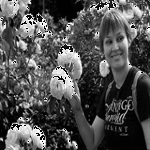

labels shape ⚡⚡⚡⚡ (22500, 1)


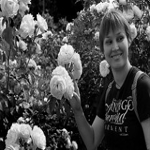

38 of total number of batches 98
<<✅✅✅epoc :  0  complete✅✅✅>>
 347.57254
logits shape ⚡⚡⚡⚡ (22500, 1)
0


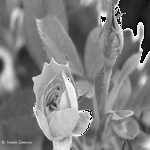

labels shape ⚡⚡⚡⚡ (22500, 1)


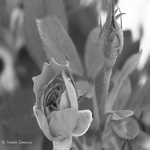

1


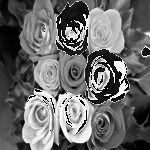

labels shape ⚡⚡⚡⚡ (22500, 1)


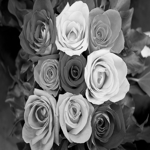

2


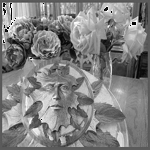

labels shape ⚡⚡⚡⚡ (22500, 1)


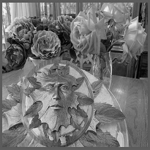

3


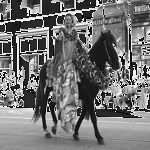

labels shape ⚡⚡⚡⚡ (22500, 1)


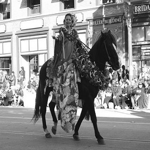

4


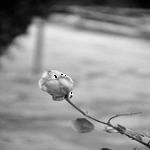

labels shape ⚡⚡⚡⚡ (22500, 1)


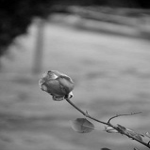

5


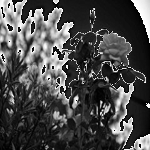

labels shape ⚡⚡⚡⚡ (22500, 1)


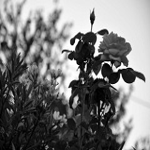

6


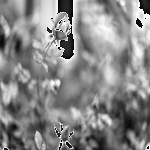

labels shape ⚡⚡⚡⚡ (22500, 1)


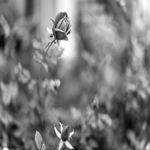

7


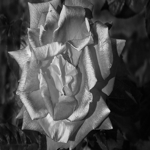

labels shape ⚡⚡⚡⚡ (22500, 1)


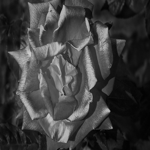

39 of total number of batches 98
<<✅✅✅epoc :  0  complete✅✅✅>>
 213.01701
logits shape ⚡⚡⚡⚡ (22500, 1)
0


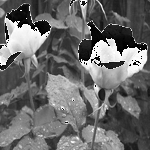

labels shape ⚡⚡⚡⚡ (22500, 1)


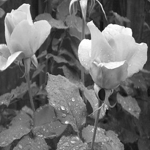

1


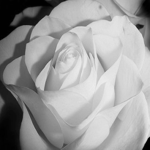

labels shape ⚡⚡⚡⚡ (22500, 1)


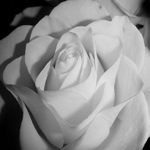

2


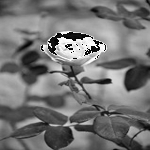

labels shape ⚡⚡⚡⚡ (22500, 1)


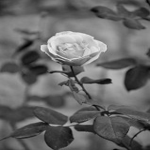

3


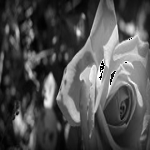

labels shape ⚡⚡⚡⚡ (22500, 1)


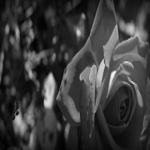

4


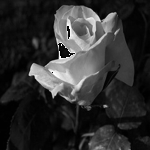

labels shape ⚡⚡⚡⚡ (22500, 1)


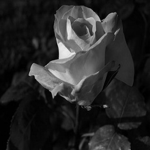

5


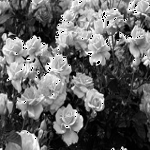

labels shape ⚡⚡⚡⚡ (22500, 1)


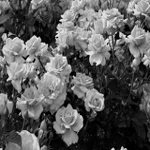

6


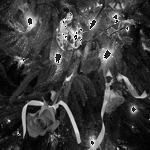

labels shape ⚡⚡⚡⚡ (22500, 1)


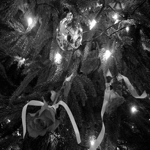

7


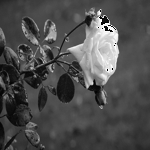

labels shape ⚡⚡⚡⚡ (22500, 1)


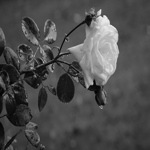

40 of total number of batches 98
<<✅✅✅epoc :  0  complete✅✅✅>>
 353.22324
logits shape ⚡⚡⚡⚡ (22500, 1)
0


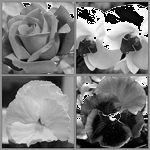

labels shape ⚡⚡⚡⚡ (22500, 1)


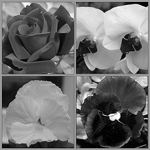

1


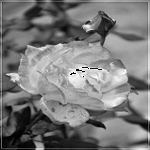

labels shape ⚡⚡⚡⚡ (22500, 1)


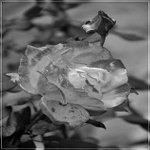

2


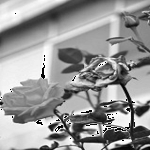

labels shape ⚡⚡⚡⚡ (22500, 1)


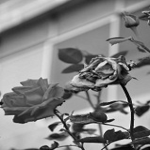

3


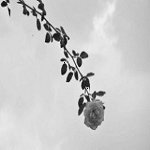

labels shape ⚡⚡⚡⚡ (22500, 1)


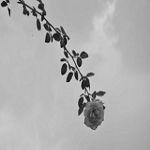

4


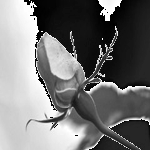

labels shape ⚡⚡⚡⚡ (22500, 1)


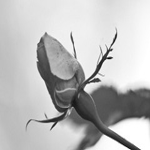

5


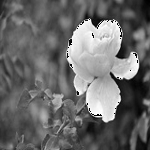

labels shape ⚡⚡⚡⚡ (22500, 1)


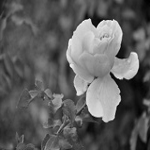

6


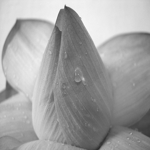

labels shape ⚡⚡⚡⚡ (22500, 1)


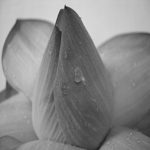

7


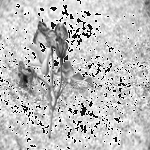

labels shape ⚡⚡⚡⚡ (22500, 1)


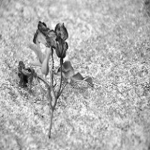

41 of total number of batches 98
<<✅✅✅epoc :  0  complete✅✅✅>>
 140.77359
logits shape ⚡⚡⚡⚡ (22500, 1)
0


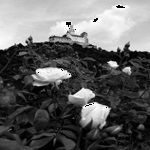

labels shape ⚡⚡⚡⚡ (22500, 1)


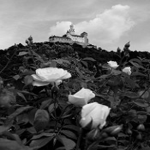

1


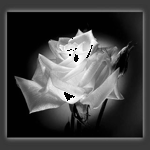

labels shape ⚡⚡⚡⚡ (22500, 1)


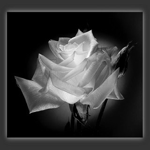

2


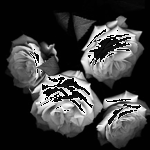

labels shape ⚡⚡⚡⚡ (22500, 1)


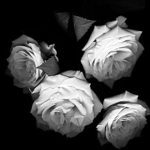

3


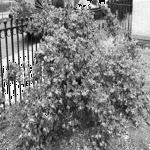

labels shape ⚡⚡⚡⚡ (22500, 1)


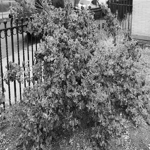

4


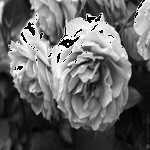

labels shape ⚡⚡⚡⚡ (22500, 1)


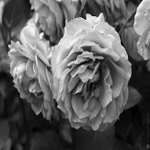

5


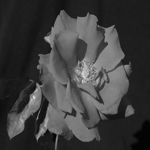

labels shape ⚡⚡⚡⚡ (22500, 1)


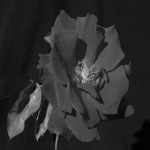

6


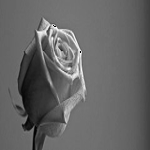

labels shape ⚡⚡⚡⚡ (22500, 1)


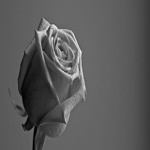

7


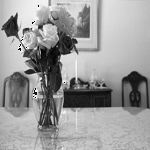

labels shape ⚡⚡⚡⚡ (22500, 1)


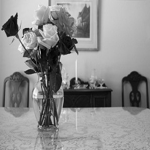

42 of total number of batches 98
<<✅✅✅epoc :  0  complete✅✅✅>>
 170.74695
logits shape ⚡⚡⚡⚡ (22500, 1)
0


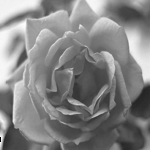

labels shape ⚡⚡⚡⚡ (22500, 1)


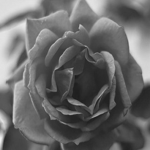

1


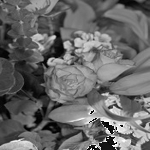

labels shape ⚡⚡⚡⚡ (22500, 1)


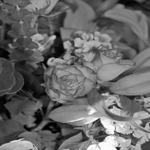

2


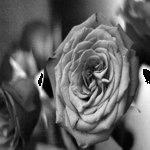

labels shape ⚡⚡⚡⚡ (22500, 1)


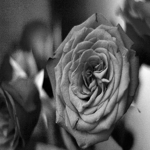

3


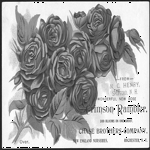

labels shape ⚡⚡⚡⚡ (22500, 1)


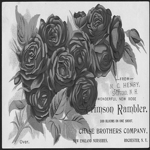

4


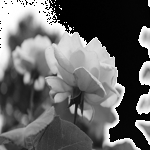

labels shape ⚡⚡⚡⚡ (22500, 1)


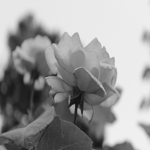

5


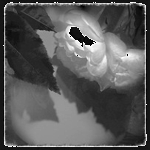

labels shape ⚡⚡⚡⚡ (22500, 1)


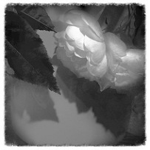

6


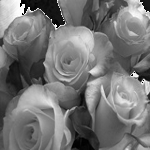

labels shape ⚡⚡⚡⚡ (22500, 1)


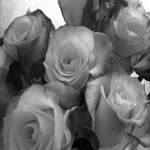

7


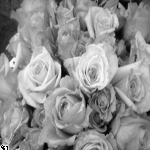

labels shape ⚡⚡⚡⚡ (22500, 1)


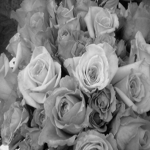

43 of total number of batches 98
<<✅✅✅epoc :  0  complete✅✅✅>>
 148.75229
logits shape ⚡⚡⚡⚡ (22500, 1)
0


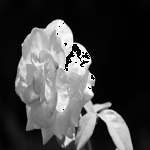

labels shape ⚡⚡⚡⚡ (22500, 1)


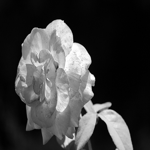

1


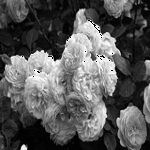

labels shape ⚡⚡⚡⚡ (22500, 1)


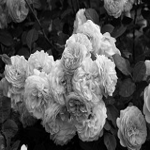

2


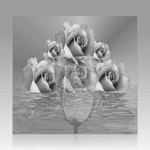

labels shape ⚡⚡⚡⚡ (22500, 1)


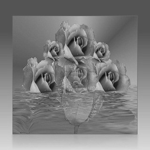

3


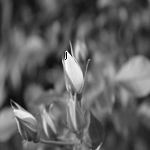

labels shape ⚡⚡⚡⚡ (22500, 1)


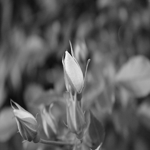

4


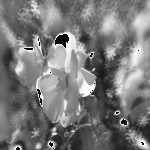

labels shape ⚡⚡⚡⚡ (22500, 1)


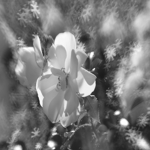

5


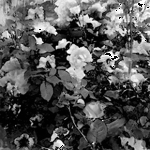

labels shape ⚡⚡⚡⚡ (22500, 1)


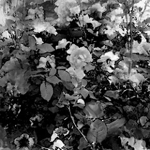

6


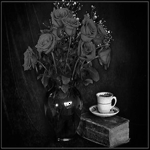

labels shape ⚡⚡⚡⚡ (22500, 1)


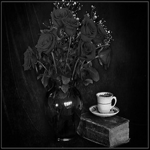

7


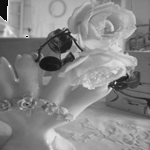

labels shape ⚡⚡⚡⚡ (22500, 1)


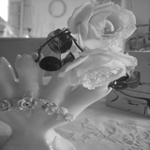

44 of total number of batches 98
<<✅✅✅epoc :  0  complete✅✅✅>>
 90.98919
logits shape ⚡⚡⚡⚡ (22500, 1)
0


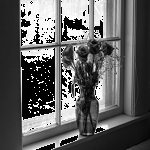

labels shape ⚡⚡⚡⚡ (22500, 1)


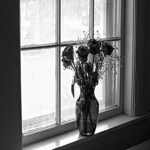

1


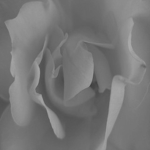

labels shape ⚡⚡⚡⚡ (22500, 1)


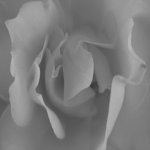

2


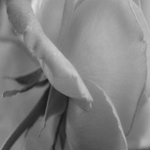

labels shape ⚡⚡⚡⚡ (22500, 1)


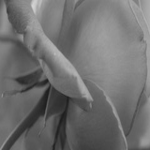

3


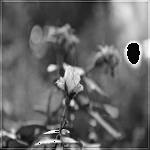

labels shape ⚡⚡⚡⚡ (22500, 1)


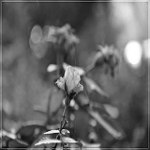

4


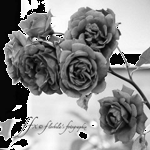

labels shape ⚡⚡⚡⚡ (22500, 1)


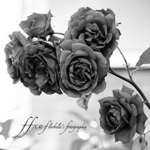

5


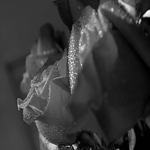

labels shape ⚡⚡⚡⚡ (22500, 1)


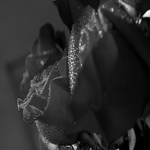

6


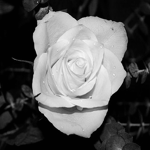

labels shape ⚡⚡⚡⚡ (22500, 1)


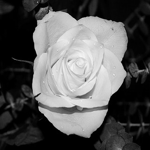

7


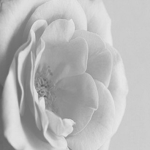

labels shape ⚡⚡⚡⚡ (22500, 1)


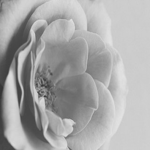

45 of total number of batches 98
<<✅✅✅epoc :  0  complete✅✅✅>>
 47.396893
logits shape ⚡⚡⚡⚡ (22500, 1)
0


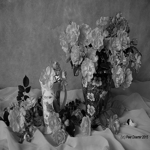

labels shape ⚡⚡⚡⚡ (22500, 1)


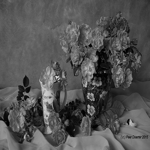

1


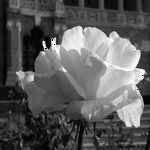

labels shape ⚡⚡⚡⚡ (22500, 1)


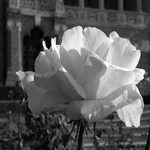

2


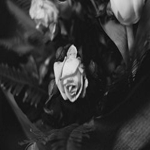

labels shape ⚡⚡⚡⚡ (22500, 1)


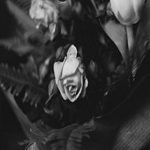

3


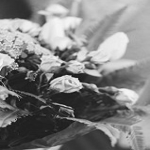

labels shape ⚡⚡⚡⚡ (22500, 1)


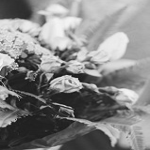

4


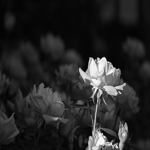

labels shape ⚡⚡⚡⚡ (22500, 1)


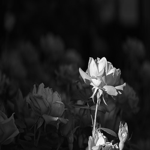

5


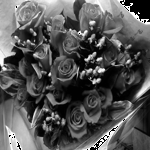

labels shape ⚡⚡⚡⚡ (22500, 1)


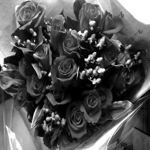

6


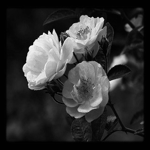

labels shape ⚡⚡⚡⚡ (22500, 1)


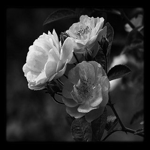

7


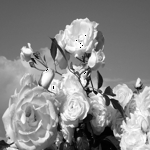

labels shape ⚡⚡⚡⚡ (22500, 1)


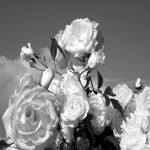

46 of total number of batches 98
<<✅✅✅epoc :  0  complete✅✅✅>>
 42.538406
logits shape ⚡⚡⚡⚡ (22500, 1)
0


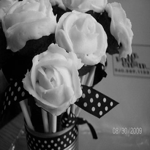

labels shape ⚡⚡⚡⚡ (22500, 1)


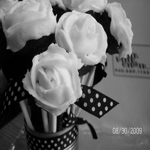

1


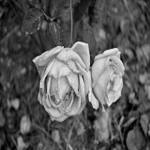

labels shape ⚡⚡⚡⚡ (22500, 1)


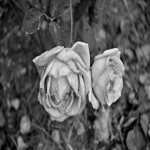

2


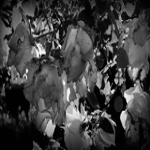

labels shape ⚡⚡⚡⚡ (22500, 1)


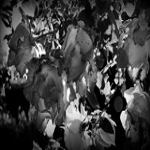

3


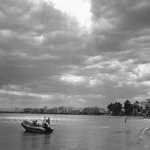

labels shape ⚡⚡⚡⚡ (22500, 1)


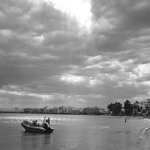

4


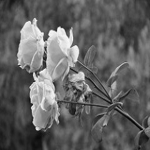

labels shape ⚡⚡⚡⚡ (22500, 1)


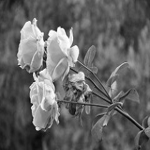

5


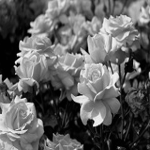

labels shape ⚡⚡⚡⚡ (22500, 1)


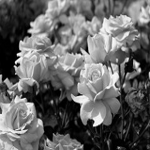

6


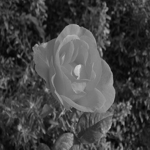

labels shape ⚡⚡⚡⚡ (22500, 1)


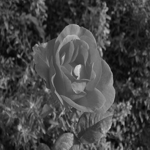

7


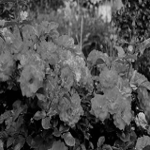

labels shape ⚡⚡⚡⚡ (22500, 1)


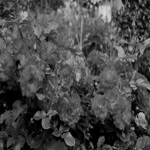

47 of total number of batches 98
<<✅✅✅epoc :  0  complete✅✅✅>>
 58.837833
logits shape ⚡⚡⚡⚡ (22500, 1)
0


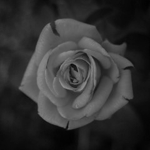

labels shape ⚡⚡⚡⚡ (22500, 1)


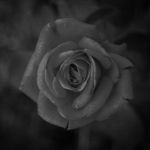

1


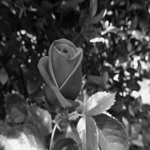

labels shape ⚡⚡⚡⚡ (22500, 1)


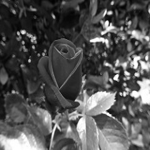

2


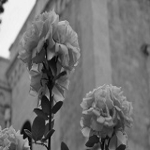

labels shape ⚡⚡⚡⚡ (22500, 1)


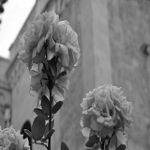

3


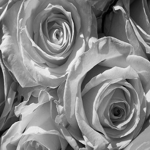

labels shape ⚡⚡⚡⚡ (22500, 1)


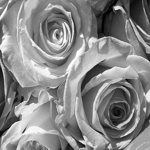

4


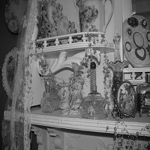

labels shape ⚡⚡⚡⚡ (22500, 1)


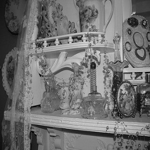

5


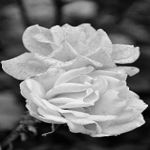

labels shape ⚡⚡⚡⚡ (22500, 1)


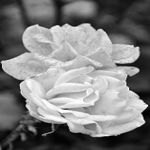

6


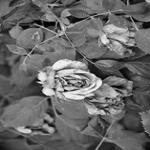

labels shape ⚡⚡⚡⚡ (22500, 1)


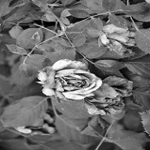

7


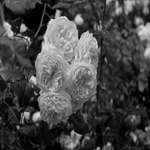

labels shape ⚡⚡⚡⚡ (22500, 1)


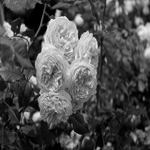

48 of total number of batches 98
<<✅✅✅epoc :  0  complete✅✅✅>>
 61.670235
logits shape ⚡⚡⚡⚡ (22500, 1)
0


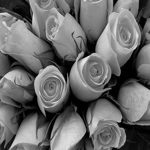

labels shape ⚡⚡⚡⚡ (22500, 1)


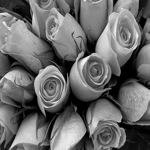

1


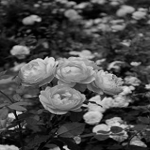

labels shape ⚡⚡⚡⚡ (22500, 1)


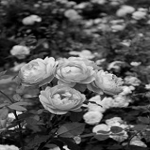

2


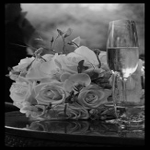

labels shape ⚡⚡⚡⚡ (22500, 1)


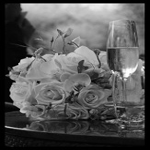

3


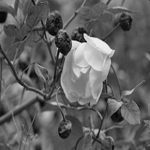

labels shape ⚡⚡⚡⚡ (22500, 1)


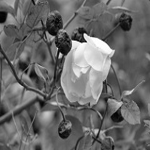

4


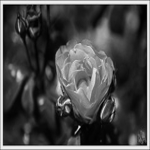

labels shape ⚡⚡⚡⚡ (22500, 1)


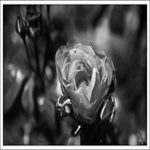

5


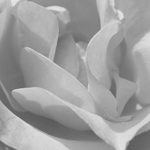

labels shape ⚡⚡⚡⚡ (22500, 1)


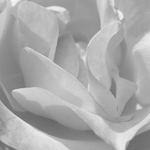

6


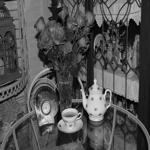

labels shape ⚡⚡⚡⚡ (22500, 1)


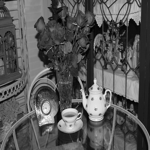

7


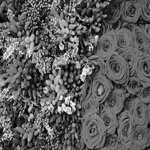

labels shape ⚡⚡⚡⚡ (22500, 1)


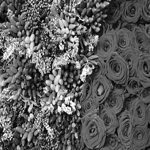

49 of total number of batches 98
<<✅✅✅epoc :  0  complete✅✅✅>>
 74.04443
logits shape ⚡⚡⚡⚡ (22500, 1)
0


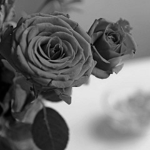

labels shape ⚡⚡⚡⚡ (22500, 1)


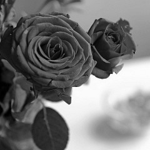

1


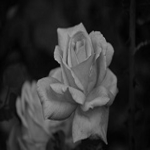

labels shape ⚡⚡⚡⚡ (22500, 1)


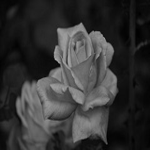

2


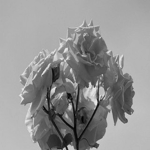

labels shape ⚡⚡⚡⚡ (22500, 1)


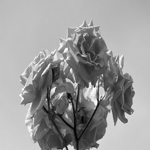

3


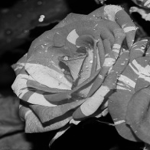

labels shape ⚡⚡⚡⚡ (22500, 1)


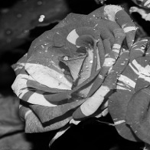

4


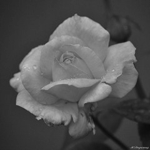

labels shape ⚡⚡⚡⚡ (22500, 1)


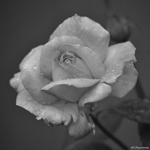

5


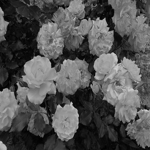

labels shape ⚡⚡⚡⚡ (22500, 1)


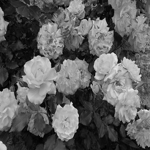

6


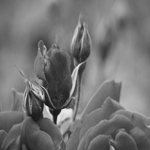

labels shape ⚡⚡⚡⚡ (22500, 1)


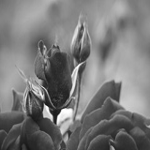

7


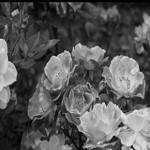

labels shape ⚡⚡⚡⚡ (22500, 1)


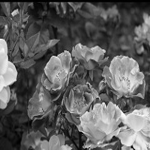

50 of total number of batches 98
<<✅✅✅epoc :  0  complete✅✅✅>>
 107.436035
logits shape ⚡⚡⚡⚡ (22500, 1)
0


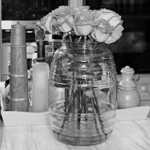

labels shape ⚡⚡⚡⚡ (22500, 1)


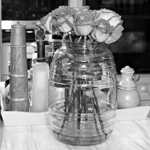

1


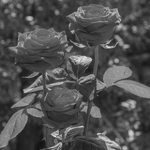

labels shape ⚡⚡⚡⚡ (22500, 1)


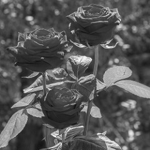

2


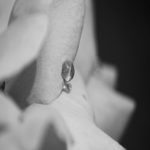

labels shape ⚡⚡⚡⚡ (22500, 1)


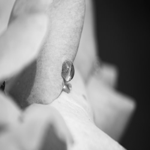

3


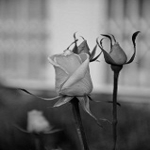

labels shape ⚡⚡⚡⚡ (22500, 1)


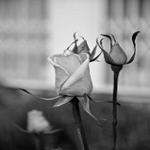

4


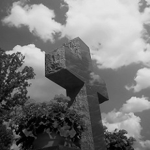

labels shape ⚡⚡⚡⚡ (22500, 1)


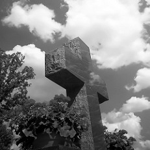

5


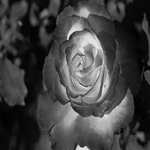

labels shape ⚡⚡⚡⚡ (22500, 1)


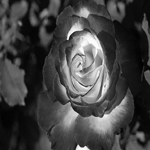

6


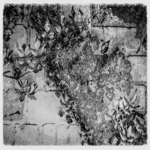

labels shape ⚡⚡⚡⚡ (22500, 1)


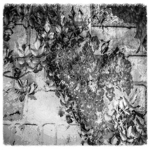

7


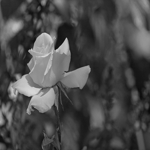

labels shape ⚡⚡⚡⚡ (22500, 1)


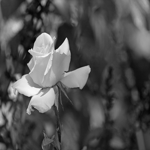

51 of total number of batches 98
<<✅✅✅epoc :  0  complete✅✅✅>>
 97.513855
logits shape ⚡⚡⚡⚡ (22500, 1)
0


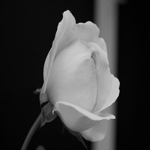

labels shape ⚡⚡⚡⚡ (22500, 1)


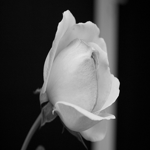

1


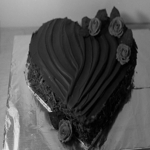

labels shape ⚡⚡⚡⚡ (22500, 1)


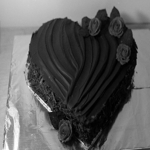

2


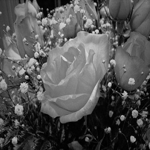

labels shape ⚡⚡⚡⚡ (22500, 1)


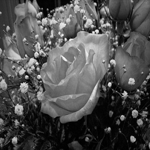

3


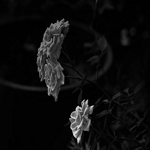

labels shape ⚡⚡⚡⚡ (22500, 1)


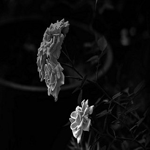

4


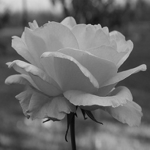

labels shape ⚡⚡⚡⚡ (22500, 1)


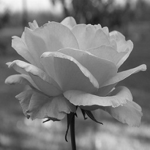

5


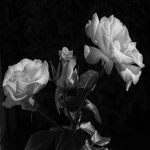

labels shape ⚡⚡⚡⚡ (22500, 1)


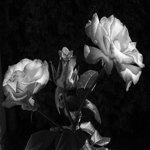

6


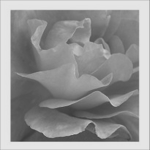

labels shape ⚡⚡⚡⚡ (22500, 1)


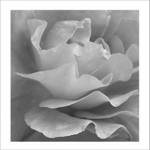

7


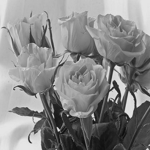

labels shape ⚡⚡⚡⚡ (22500, 1)


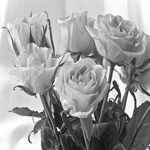

52 of total number of batches 98
<<✅✅✅epoc :  0  complete✅✅✅>>
 133.52098
logits shape ⚡⚡⚡⚡ (22500, 1)
0


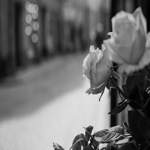

labels shape ⚡⚡⚡⚡ (22500, 1)


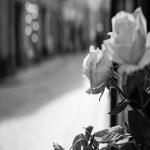

1


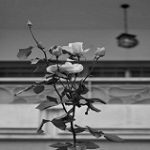

labels shape ⚡⚡⚡⚡ (22500, 1)


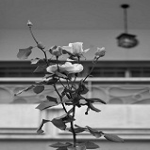

2


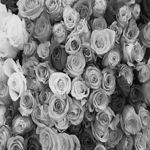

labels shape ⚡⚡⚡⚡ (22500, 1)


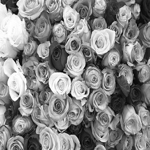

3


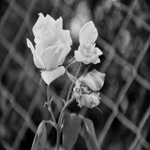

labels shape ⚡⚡⚡⚡ (22500, 1)


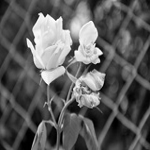

4


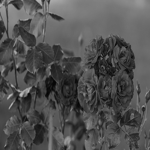

labels shape ⚡⚡⚡⚡ (22500, 1)


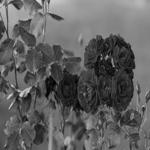

5


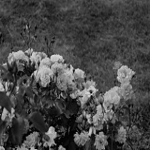

labels shape ⚡⚡⚡⚡ (22500, 1)


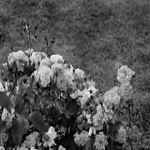

6


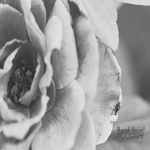

labels shape ⚡⚡⚡⚡ (22500, 1)


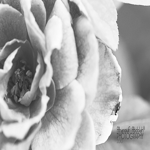

7


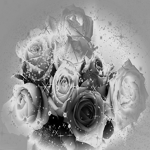

labels shape ⚡⚡⚡⚡ (22500, 1)


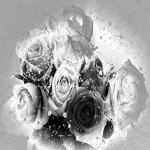

53 of total number of batches 98
<<✅✅✅epoc :  0  complete✅✅✅>>
 146.21585
logits shape ⚡⚡⚡⚡ (22500, 1)
0


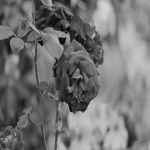

labels shape ⚡⚡⚡⚡ (22500, 1)


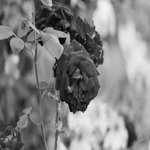

1


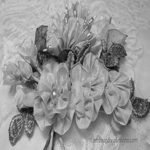

labels shape ⚡⚡⚡⚡ (22500, 1)


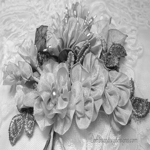

2


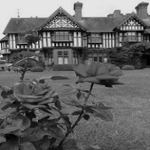

labels shape ⚡⚡⚡⚡ (22500, 1)


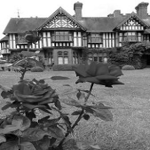

3


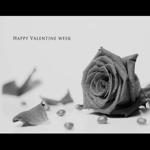

labels shape ⚡⚡⚡⚡ (22500, 1)


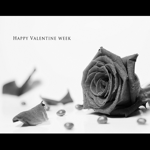

4


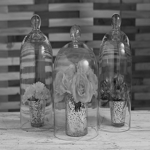

labels shape ⚡⚡⚡⚡ (22500, 1)


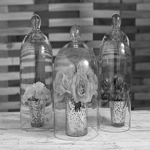

5


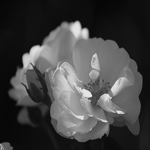

labels shape ⚡⚡⚡⚡ (22500, 1)


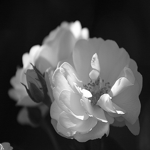

6


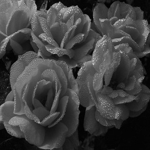

labels shape ⚡⚡⚡⚡ (22500, 1)


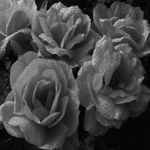

7


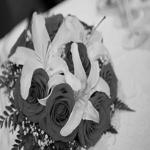

labels shape ⚡⚡⚡⚡ (22500, 1)


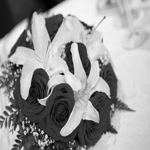

54 of total number of batches 98
<<✅✅✅epoc :  0  complete✅✅✅>>
 

KeyboardInterrupt: ignored

In [28]:
#@title ## **👠HIGH HEELS RUN >>>>>>>>>>>** { vertical-output: true }
import jax
from jax import random
def batchedimages(image_locations):
  ddyss = jnp.asarray((imageRGB(total_images_path[image_locations[0]])[1],
                      imageRGB(total_images_path[image_locations[1]])[1],
                      imageRGB(total_images_path[image_locations[2]])[1],
                      imageRGB(total_images_path[image_locations[3]])[1],
                      imageRGB(total_images_path[image_locations[4]])[1],
                      imageRGB(total_images_path[image_locations[5]])[1],
                      imageRGB(total_images_path[image_locations[6]])[1],
                      imageRGB(total_images_path[image_locations[7]])[1]))
  ddxss = jnp.asarray((imageGRAY(total_images_path[image_locations[0]])[1],
                      imageGRAY(total_images_path[image_locations[1]])[1],
                      imageGRAY(total_images_path[image_locations[2]])[1],
                      imageGRAY(total_images_path[image_locations[3]])[1],
                      imageGRAY(total_images_path[image_locations[4]])[1],
                      imageGRAY(total_images_path[image_locations[5]])[1],
                      imageGRAY(total_images_path[image_locations[6]])[1],
                      imageGRAY(total_images_path[image_locations[7]])[1]))
  #print(ddyss.shape,"<<<< ddyss.shape???",ddxss.shape,"<<<< ddxss.shape???") #to check shape 
  batch_ccc = ddyss, ddxss
  return batch_ccc
  
def data_stream():
  key = random.PRNGKey(0)
  perm = random.permutation(key, len(total_images_path))
  for i in range(no_of_batches):
    batch_idx = perm[i * batch_size : (i + 1) * batch_size]; #print(batch_idx)
    yield batchedimages(batch_idx)

batches = data_stream()  ### this stream will utilize the array of paths of images to a folder, then "generate" batches into the variable

next(batches)[0].shape ### this command starts initial 8 image  stream, if callled inside a iteration loop then it will get next images for calculations>>>
vv, shapea, channels = next(batches)[0].shape # seitting values >>> [0] 8 784 3  [1] 8 784 1 ; RGB & GRAYSCALE versions 8 images each converted to 1-D array
print(vv, shapea, channels)
######################<<< summary writer for tensor board
# from torch.utils.tensorboard import SummaryWriter
# logdir = "runs"
# writer = SummaryWriter(logdir)
######################
######################
rng = jax.random.PRNGKey(0)
# dropout_rngs = jax.random.split(rng, jax.local_device_count())
######################
#################################<<< checking if checkpoint already available
import os # importing os module
import re # to find file using regular expression
checkpoint_available = 0
pattern = re.compile("checkpoint_\d+")   # to search for "checkpoint_*munerical value*" numerical value of any length is denoted by regular expression "\d+"
dir = "/content/ckpts/"
isFile = os.path.isdir(dir)
if isFile:
  for filepath in os.listdir(dir):
      if pattern.match(filepath):
          checkpoint_available = 1
#################################
##########################################<<< loading checkpoint by checking the Flag available
from flax.training import checkpoints
if checkpoint_available:
  CKPT_DIR = 'ckpts'
  restored_state = checkpoints.restore_checkpoint(ckpt_dir=CKPT_DIR, target=state)
  #state = flax.jax_utils.replicate(restored_state)
  print("true <<< File loaded for and replicated to all devices")
##########################################
######################<<<< initiating train state
count = 0
if count == 0 :
  state = init_train_state( model, rng, (shapea, channels), learning_rate ) 
  count = 1
state = flax.jax_utils.replicate(state)  # FLAX will replicate the state to every device so that updating can be made easy
dropout_rngs = jax.random.split(rng, jax.local_device_count())
######################
from flax.training import checkpoints
import time
total_epochs = 50
for epochs in range(total_epochs):   # EPOCHS for training & updating the initiated state, metrics may show the loss in each epochs or iteration
  start_time = time.time()
  batches = data_stream()  ### this stream will utilize the array of paths of images to a folder, then "generate" batches into the variable
  if checkpoint_available:
    CKPT_DIR = 'ckpts'
    restored_state = checkpoints.restore_checkpoint(ckpt_dir=CKPT_DIR, target=state)
    state = restored_state
    checkpoint_available = 0 # << Flag updated >>> to stop loading the same checkpoint in the next iteration then remove the checkpoint directory
    !rm -r /content/ckpts
  for bbb in range(no_of_batches-5):
    print(bbb,"of total number of batches",no_of_batches)
    state, metrics = parallel_train_step(state, next(batches), dropout_rngs)
    print("<<✅✅✅epoc : ",epochs," complete✅✅✅>>\n",metrics['loss'][0]) #printing loss 1 out of 8 processed in 8 devices
    
    #############################################<<< output visualization 👍🏻
    from google.colab.patches import cv2_imshow
    import numpy as np        # source : https://www.folkstalk.com/tech/how-to-convert-numpy-array-to-cv2-image-with-code-examples/
    
    print("logits shape ⚡⚡⚡⚡", metrics['logits'][0].shape)
    L1 = metrics['logits'][0]
    # predicted_image = np.array(L1,  dtype=np.uint8).reshape(newsize) # This would be your image array
    # cv2img = cv2_imshow(predicted_image) # This work the same as passing an image
    for i in range(0,metrics['labels'].shape[0]):
      print(i)
      predicted_image = np.array(metrics['logits'][i],  dtype=np.uint8).reshape(newsize) # This would be your image array
      cv2_imshow(predicted_image)

      print("labels shape ⚡⚡⚡⚡", metrics['labels'][0].shape)
      L2 = metrics['labels'][0]
      actual_image = np.array(metrics['labels'][i],  dtype=np.uint8).reshape(newsize) # This would be your image array newsize = image_width , image_height
      cv2img = cv2_imshow(actual_image) # This work the same as passing an image
    #############################################<<< output visualization 👍🏻
    

    

    writer.add_scalar('Loss', int(metrics['loss'][0]), epochs)
  epoch_time = time.time() - start_time
  print(f"Epoch {epochs} in {epoch_time:0.2f} sec")
  ##################################################<<< model saving mechanism for flax model state as checkpoints for each epochs,"checkpoint" is a terminology that means all the model weights and biases during the calculation till the completion of 1 epoch were being updated, then this final set of weights and biases including their placement inside the model will be saves as a (schema+weight values) saved as checkpoint in the mentioned <<CKPT_DIR = 'ckpts'>> mentioned folder.  
  CKPT_DIR = 'ckpts'
  checkpoints.save_checkpoint(ckpt_dir=CKPT_DIR, target=state, step= epochs)     # naming of the checkpoint is "checkpoint_*"  where "*" => value of the steps variable, i.e. 'epochs'
  restored_state = checkpoints.restore_checkpoint(ckpt_dir=CKPT_DIR, target=state) # using to get the checkpoint loaded , it can be latest one , or if already available as checkpoint in the "CKPT_DIR" directory then take the file from directory then save in >> restored_checkpoints
  ##################################################
  # images = total_images_path[batch_idx]
writer.flush()

In [ ]:
from google.colab.patches import cv2_imshow
import numpy        # source : https://www.folkstalk.com/tech/how-to-convert-numpy-array-to-cv2-image-with-code-examples/
predicted_image = np.array(L1,  dtype=np.uint8).reshape(newsize) # This would be your image array
cv2img = cv2_imshow(predicted_image) # This work the same as passing an image


actual_image = np.array(L2,  dtype=np.uint8).reshape(newsize) # This would be your image array
cv2img = cv2_imshow(actual_image) # This work the same as passing an image



### **SETING UP INFERENCE** 🖼️🥽.

In [ ]:
def batchedimages(image_locations):
  ddyss = jnp.asarray((imageRGB(image_locations)[1],
                      imageRGB(image_locations)[1],
                      imageRGB(image_locations)[1],
                      imageRGB(image_locations)[1],
                      imageRGB(image_locations)[1],
                      imageRGB(image_locations)[1],
                      imageRGB(image_locations)[1],
                      imageRGB(image_locations)[1]))
  ddxss = jnp.asarray((imageGRAY(image_locations)[1],
                      imageGRAY(image_locations)[1],
                      imageGRAY(image_locations)[1],
                      imageGRAY(image_locations)[1],
                      imageGRAY(image_locations)[1],
                      imageGRAY(image_locations)[1],
                      imageGRAY(image_locations)[1],
                      imageGRAY(image_locations)[1]))
  #print(ddyss.shape,"<<<< ddyss.shape???",ddxss.shape,"<<<< ddxss.shape???") #to check shape 
  batch_ccc = ddyss, ddxss
  return batch_ccc

IMAGE_PATHS = "/content/a.jpg"
batches = batchedimages(IMAGE_PATHS)  ### this stream will utilize the array of paths of images to a folder, then "generate" batches into the variable

batches[0].shape ### this command starts initial 8 image  stream, if callled inside a iteration loop then it will get next images for calculations>>>
vv, shapea, channels = batches[0].shape # seitting values >>> [0] 8 784 3  [1] 8 784 1 ; RGB & GRAYSCALE versions 8 images each converted to 1-D array
print(vv, shapea, channels)

##################################################<<< model saving mechanism for flax model state as checkpoints for each epochs,"checkpoint" is a terminology that means all the model weights and biases during the calculation till the completion of 1 epoch were being updated, then this final set of weights and biases including their placement inside the model will be saves as a (schema+weight values) saved as checkpoint in the mentioned <<CKPT_DIR = 'ckpts'>> mentioned folder.  
state = init_train_state( model, rng, (shapea, channels), learning_rate ) 
state = flax.jax_utils.replicate(state)  # FLAX will replicate the state to every device so that updating can be made easy
dropout_rngs = jax.random.split(rng, jax.local_device_count())

CKPT_DIR = 'ckpts'
restored_state = checkpoints.restore_checkpoint(ckpt_dir=CKPT_DIR, target=state) # using to get the checkpoint loaded , it can be latest one , or if already available as checkpoint in the "CKPT_DIR" directory then take the file from directory then save in >> restored_checkpoints
##################################################

state, metrics = parallel_train_step(restored_state, batches, dropout_rngs)
print("<<Calculations complete✅✅✅ loss: >>",metrics['loss'][0]) #printing loss 1 out of 8 processed in 8 devices

#############################################<<< output visualization 👍🏻
from google.colab.patches import cv2_imshow
import numpy as np       # source : https://www.folkstalk.com/tech/how-to-convert-numpy-array-to-cv2-image-with-code-examples/

print("logits shape ⚡⚡⚡⚡", metrics['logits'][0].shape)
L1 = metrics['logits'][0]
predicted_image = np.array(L1,  dtype=np.uint8).reshape(newsize) # This would be your image array
cv2img = cv2_imshow(predicted_image) # This work the same as passing an image

print("labels shape ⚡⚡⚡⚡", metrics['labels'][0].shape)
L2 = metrics['labels'][0]
actual_image = np.array(L2,  dtype=np.uint8).reshape(newsize) # This would be your image array newsize = image_width , image_height
cv2img = cv2_imshow(actual_image) # This work the same as passing an image
#############################################<<< output visualization 👍🏻


In [ ]:
metrics['labels'].shape[0]
images = []
from google.colab.patches import cv2_imshow
import cv2
for i in range(0,metrics['labels'].shape[0]):
  print(i)
  predicted_image = np.array(metrics['labels'][i], dtype=np.uint8).reshape(newsize) # This would be your image array
  cv2img = cv2_imshow(predicted_image)

#  cv2img = cv2_imshow(predicted_image) # This work the same as passing an image
# cv2img = cv2_imshow(images)
len(images)
print(predicted_image)

### **GeoTiff to Image & Imahe to GeoTiff Conversion**

In [ ]:
!gdown https://drive.google.com/uc?id=1-6Mxg3hroKxXFGBn3y6wIEHK1L6GdgwJ #downloading DEM-MAP https://drive.google.com/file/d/1-6Mxg3hroKxXFGBn3y6wIEHK1L6GdgwJ/view?usp=share_link
%cd /content

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import os.path
import re

from osgeo import gdal
from osgeo import gdal_array
from osgeo import osr

def get_gain_band(input_file):
    """get GAIN_BAND from meta file (*.tif.txt)"""
     # define file name of *.tif.txt
    ifile_txt = re.sub(r'.tif', '.tif.txt', input_file)
    ld = open(ifile_txt)
    lines = ld.readlines()
    ld.close()
    
    gain_band = []
    for line in lines:
        if line.find("GAIN_BAND") >= 0:
             gain_band.append(float((re.split(' ', line)[1]).strip()))
    return gain_band

def tif2array(input_file, calc_gain=True):
    """
    read GeoTiff and convert to numpy.ndarray.
    Inputs:
        input_file (str) : the name of input GeoTiff file.
        calc_gain (bool) : wheter calc GAIN to DN  or not (defaul:True).
    return:
        image(np.array) : image for each bands
        dataset : for gdal's data drive.
    """
    dataset = gdal.Open(input_file, gdal.GA_ReadOnly)
    # Allocate our array using the first band's datatype
    image_datatype = dataset.GetRasterBand(1).DataType
    image = np.zeros((dataset.RasterYSize, dataset.RasterXSize, dataset.RasterCount),
                     dtype=float)
    
    if calc_gain == True:
        # get gain
        gain = get_gain_band(input_file)
    
    # Loop over all bands in dataset
    for b in range(dataset.RasterCount):
        # Remember, GDAL index is on 1, but Python is on 0 -- so we add 1 for our GDAL calls
        band = dataset.GetRasterBand(b + 1)
        # Read in the band's data into the third dimension of our array
        if calc_gain == True:
            # calc gain value for each bands
            image[:, :, b] = band.ReadAsArray() * gain[b]
        else:
            image[:, :, b] = band.ReadAsArray()
    return image, dataset

def array2raster(newRasterfn, dataset, array, dtype):
    """
    save GTiff file from numpy.array
    input:
        newRasterfn: save file name
        dataset : original tif file
        array : numpy.array
        dtype: Byte or Float32.
    """
    cols = array.shape[1]
    rows = array.shape[0]
    originX, pixelWidth, b, originY, d, pixelHeight = dataset.GetGeoTransform() 

    driver = gdal.GetDriverByName('GTiff')

    # set data type to save.
    GDT_dtype = gdal.GDT_Unknown
    if dtype == "Byte": 
        GDT_dtype = gdal.GDT_Byte
    elif dtype == "Float32":
        GDT_dtype = gdal.GDT_Float32
    else:
        print("Not supported data type.")

    # set number of band.
    if array.ndim == 2:
        band_num = 1
    else:
        band_num = array.shape[2]

    outRaster = driver.Create(newRasterfn, cols, rows, band_num, GDT_dtype)
    outRaster.SetGeoTransform((originX, pixelWidth, 0, originY, 0, pixelHeight))

    # # Loop over all bands.
    # for b in range(band_num):
    #     outband = outRaster.GetRasterBand(b + 1)
    #     # Read in the band's data into the third dimension of our array
    #     if band_num == 1:
    #         outband.WriteArray(array)
    #     else:
    #         outband.WriteArray(array[:,:,b])
    outband = outRaster.GetRasterBand(1)
    outband.WriteArray(array.reshape(rows, cols))
    # setting srs from input tif file.
    prj=dataset.GetProjection()
    outRasterSRS = osr.SpatialReference(wkt=prj)
    outRaster.SetProjection(outRasterSRS.ExportToWkt())
    outband.FlushCache()
    return newRasterfn

In [ ]:
INPUT.ndim
INPUT.reshape(INPUT.shape[0],INPUT.shape[1]).shape

In [ ]:
INPUT_PATH = "/content/MOD09A1.061_sur_refl_b01_doy2000065_aid0001.tif"
INPUT,Datasetq = tif2array(INPUT_PATH,0)
type(INPUT)
print(INPUT,Datasetq)
len(INPUT)
INPUT[0].shape
dataset = gdal.Open(INPUT_PATH, gdal.GA_ReadOnly)
originX, pixelWidth, b, originY, d, pixelHeight = dataset.GetGeoTransform() 
print(originX, pixelWidth, b, originY, d, pixelHeight)
print(INPUT.shape)
OUTPUT = array2raster("geo1.tif", Datasetq, INPUT, "Float32")

type(OUTPUT)
OUTPUT

In [ ]:
print(INPUT.shape)
INPUT[0][:,:].shape
from google.colab.patches import cv2_imshow
cv2img = cv2_imshow(OUTPUT)
